# Importing required libraries

In [ ]:
import pandas as pd
import torch
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import statsmodels.api as sm
import patsy
import scipy.stats as stats
import re


# Create DataFrame


In [ ]:
df= pd.read_csv('unclean_dataset.csv')
pd.set_option('display.max_columns', 75)
pd.set_option('display.max_rows', 100)



In [ ]:
df.head()


,name,Age,Overall rating,Potential,ID,Height,Weight,foot,Best overall,Best position,Growth,Value,Wage,Release clause,Total attacking,Crossing,Finishing,Heading accuracy,Short passing,Volleys,Total skill,Dribbling,Curve,FK Accuracy,Long passing,Ball control,Total movement,Acceleration,Sprint speed,Agility,Reactions,Balance,Total power,Shot power,Jumping,Stamina,Strength,Long shots,Total mentality,Aggression,Interceptions,Positioning,Vision,Penalties,Composure,Total defending,Marking,Standing tackle,Sliding tackle,Total goalkeeping,GK Diving,GK Handling,GK Kicking,GK Positioning,GK Reflexes,Total stats,Base stats,International reputation,Pace / Diving,Shooting / Handling,Passing / Kicking,Dribbling / Reflexes,Defending / Pace,team,contract,Team & Contract
0,J. Todibo,22,79,84,245388,190 cm,88 kg,Right,81,CB,5,€24.5M,€37.0K,€48.4M,286,49,44,80,78,35,301,66,52,41,70,72,335,68,81,55,76,55,335,60,76,73,81,45,305,72,80,45,56,52,78,238,80,80,78,52,7,13,11,8,13,1852,409,1,75,47,63,67,80,Nice,2021 ~ 2027,Nice\n2021 ~ 2027
1,B. Verbruggen,19,73,83,258498,194 cm,89 kg,Right,73,GK,10,€5.5M,€6.0K,€9.4M,74,10,8,15,35,6,89,15,11,15,30,18,244,52,52,32,73,35,218,53,65,21,72,7,99,17,19,4,38,21,30,43,12,17,14,360,75,70,71,68,76,1127,412,1,75,70,71,76,52,Anderlecht,2020 ~ 2025,Anderlecht\n2020 ~ 2025
2,M. Ugarte,21,79,85,253306,182 cm,77 kg,Right,80,CDM,6,€26.0M,€11.0K,€57.2M,286,58,65,39,79,45,339,79,54,50,79,77,349,71,72,69,77,60,336,62,53,83,73,65,355,73,83,75,74,50,84,232,77,80,75,53,6,10,16,8,13,1950,433,1,72,63,71,77,75,Sporting CP,2021 ~ 2026,Sporting CP\n2021 ~ 2026
3,Z. Debast,18,70,84,254262,189 cm,76 kg,Right,72,CDM,14,€3.5M,€3.0K,€7.4M,296,69,51,68,71,37,331,69,58,59,74,71,310,61,71,56,69,53,327,60,66,74,71,56,295,75,67,53,58,42,67,208,68,71,69,38,6,6,15,6,5,1805,395,1,67,53,67,67,69,Anderlecht,2019 ~ 2025,Anderlecht\n2019 ~ 2025
4,07 D. Last,37,61,60,21555,182 cm,82 kg,Right,61,GK,-1,€0,€0,€0,137,35,32,35,35,0,139,35,0,33,63,8,146,44,46,0,56,0,134,30,0,45,51,8,74,41,0,0,0,33,0,61,28,33,0,248,63,55,63,70,60,939,356,3,63,55,63,60,45,Örgryte,2009,Örgryte\n2009


# Check for null values

In [ ]:
df.isnull().sum()


name                        0
Age                         0
Overall rating              0
Potential                   0
ID                          0
Height                      0
Weight                      0
foot                        0
Best overall                0
Best position               0
Growth                      0
Value                       0
Wage                        0
Release clause              0
Total attacking             0
Crossing                    0
Finishing                   0
Heading accuracy            0
Short passing               0
Volleys                     0
Total skill                 0
Dribbling                   0
Curve                       0
FK Accuracy                 0
Long passing                0
Ball control                0
Total movement              0
Acceleration                0
Sprint speed                0
Agility                     0
Reactions                   0
Balance                     0
Total power                 0
Shot power

In [ ]:
df[['Value']]


,Value
0,€24.5M
1,€5.5M
2,€26.0M
3,€3.5M
4,€0
...,...
2697,€11.5M
2698,€2.0M
2699,€7.0M
2700,€1.5M


# Checking the stats overview of the data

In [ ]:
df.describe()


,Age,Overall rating,Potential,ID,Best overall,Growth,Total attacking,Crossing,Finishing,Heading accuracy,Short passing,Volleys,Total skill,Dribbling,Curve,FK Accuracy,Long passing,Ball control,Total movement,Acceleration,Sprint speed,Agility,Reactions,Balance,Total power,Shot power,Jumping,Stamina,Strength,Long shots,Total mentality,Aggression,Interceptions,Positioning,Vision,Penalties,Composure,Total defending,Marking,Standing tackle,Sliding tackle,Total goalkeeping,GK Diving,GK Handling,GK Kicking,GK Positioning,GK Reflexes,Total stats,Base stats,International reputation,Pace / Diving,Shooting / Handling,Passing / Kicking,Dribbling / Reflexes,Defending / Pace
count,2702.000000,2702.000000,2702.000000,2702.000000,2702.000000,2702.000000,2702.000000,2702.000000,2702.000000,2702.000000,2702.000000,2702.000000,2702.000000,2702.000000,2702.000000,2702.000000,2702.000000,2702.000000,2702.000000,2702.000000,2702.000000,2702.000000,2702.000000,2702.000000,2702.000000,2702.000000,2702.000000,2702.000000,2702.000000,2702.000000,2702.000000,2702.000000,2702.000000,2702.000000,2702.000000,2702.000000,2702.000000,2702.000000,2702.000000,2702.000000,2702.000000,2702.000000,2702.000000,2702.000000,2702.000000,2702.000000,2702.000000,2702.000000,2702.000000,2702.000000,2702.000000,2702.000000,2702.000000,2702.000000,2702.000000
mean,23.515914,71.976684,78.401925,237167.354552,73.208734,6.425241,285.952628,57.235381,54.471873,56.950407,67.205774,50.089193,299.808290,65.626573,56.407846,48.910437,61.157661,67.705774,347.836788,70.801258,70.901925,69.324944,68.659511,68.149149,320.385270,64.706884,66.221318,67.807920,66.905255,54.743893,287.083642,61.126203,51.070688,58.959660,62.422650,53.504441,65.928201,153.566247,51.074019,52.753886,49.738342,71.329016,14.368246,14.164323,14.231680,14.232420,14.465581,1765.961880,389.003701,1.335677,73.003701,59.917839,64.500000,70.211695,53.787195
std,4.416439,7.000437,5.549598,30408.694874,6.821365,5.549561,70.326967,17.367239,19.812966,16.740913,12.589518,18.518765,73.571009,17.122057,18.246416,17.634387,13.553094,14.853064,52.175483,13.484867,13.338431,14.191407,9.025300,14.433020,48.555483,12.774376,12.685932,14.438488,12.638067,19.229385,61.693061,16.252041,21.836469,19.381596,13.382219,15.750830,12.664820,63.923570,20.961780,21.995198,21.909342,77.345785,15.988966,15.405311,15.180135,15.743596,16.374078,254.447228,39.500603,0.713373,10.067892,14.266410,9.768393,9.018696,17.897531
min,16.000000,48.000000,56.000000,41.000000,49.000000,-7.000000,48.000000,7.000000,3.000000,5.000000,14.000000,0.000000,59.000000,5.000000,0.000000,5.000000,15.000000,8.000000,105.000000,15.000000,14.000000,0.000000,34.000000,0.000000,134.000000,17.000000,0.000000,16.000000,24.000000,4.000000,51.000000,12.000000,0.000000,0.000000,0.000000,8.000000,0.000000,23.000000,5.000000,7.000000,0.000000,12.000000,1.000000,2.000000,2.000000,2.000000,2.000000,815.000000,263.000000,1.000000,30.000000,21.000000,30.000000,33.000000,15.000000
25%,20.000000,67.000000,75.000000,227704.750000,68.000000,1.000000,258.000000,49.000000,41.000000,48.000000,63.000000,37.000000,270.000000,62.000000,46.000000,37.000000,54.000000,64.000000,324.000000,64.250000,65.000000,63.000000,63.000000,61.000000,290.000000,56.000000,58.000000,62.000000,59.000000,43.000000,260.000000,52.000000,30.000000,52.000000,55.000000,44.000000,60.000000,96.000000,33.000000,33.000000,29.000000,47.000000,8.000000,8.000000,8.000000,8.000000,8.000000,1637.000000,362.000000,1.000000,67.000000,51.000000,58.000000,65.000000,38.000000
50%,23.000000,72.000000,79.000000,242172.000000,73.500000,6.000000,296.000000,61.000000,60.000000,59.000000,69.000000,52.000000,310.000000,70.000000,59.000000,48.000000,63.000000,71.000000,356.000000,73.000000,73.000000,72.000000,69.000000,70.000000,326.000000,66.000000,67.000000,70.000000,68.000000,59.000000,295.000000,64.000000,57.000000,64.000000,64.000000,55.000000,67.000000,171.000000,56.000000,60.000000,56.000000,52.000000,11.000000,10.000000,11.00

# Check for duplicates in data

In [ ]:
df.duplicated().sum()

0

# preprocessing

In [ ]:
df['Weight'] = df['Weight'].str.split(' ').str[0]
pattern = re.compile(r'\D+')
df['Weight'] = [int(pattern.sub('', weight)) for weight in df['Weight']]

In [ ]:

df['Height'] = df['Height'].str.split(' ').str[0]
df['Height'] = [int(pattern.sub('', height)) for height in df['Height']]

In [ ]:

df['new_values'] = df["Value"].str[1:]
new_values = []
for value in df['new_values']:
    if 'M' in value:
        new_values.append(float(value.replace('M', '')) * 1000000)
    elif 'K' in value:
        new_values.append(float(value.replace('K', '')) * 1000)
    else:
        new_values.append(float(value))

=df['new_values_series'] = new_values
df.head()

,name,Age,Overall rating,Potential,ID,Height,Weight,foot,Best overall,Best position,Growth,Value,Wage,Release clause,Total attacking,Crossing,Finishing,Heading accuracy,Short passing,Volleys,Total skill,Dribbling,Curve,FK Accuracy,Long passing,Ball control,Total movement,Acceleration,Sprint speed,Agility,Reactions,Balance,Total power,Shot power,Jumping,Stamina,Strength,Long shots,Total mentality,Aggression,Interceptions,Positioning,Vision,Penalties,Composure,Total defending,Marking,Standing tackle,Sliding tackle,Total goalkeeping,GK Diving,GK Handling,GK Kicking,GK Positioning,GK Reflexes,Total stats,Base stats,International reputation,Pace / Diving,Shooting / Handling,Passing / Kicking,Dribbling / Reflexes,Defending / Pace,team,contract,Team & Contract,new_values,new_values_series
0,J. Todibo,22,79,84,245388,190,88,Right,81,CB,5,€24.5M,€37.0K,€48.4M,286,49,44,80,78,35,301,66,52,41,70,72,335,68,81,55,76,55,335,60,76,73,81,45,305,72,80,45,56,52,78,238,80,80,78,52,7,13,11,8,13,1852,409,1,75,47,63,67,80,Nice,2021 ~ 2027,Nice\n2021 ~ 2027,24.5M,24500000.0
1,B. Verbruggen,19,73,83,258498,194,89,Right,73,GK,10,€5.5M,€6.0K,€9.4M,74,10,8,15,35,6,89,15,11,15,30,18,244,52,52,32,73,35,218,53,65,21,72,7,99,17,19,4,38,21,30,43,12,17,14,360,75,70,71,68,76,1127,412,1,75,70,71,76,52,Anderlecht,2020 ~ 2025,Anderlecht\n2020 ~ 2025,5.5M,5500000.0
2,M. Ugarte,21,79,85,253306,182,77,Right,80,CDM,6,€26.0M,€11.0K,€57.2M,286,58,65,39,79,45,339,79,54,50,79,77,349,71,72,69,77,60,336,62,53,83,73,65,355,73,83,75,74,50,84,232,77,80,75,53,6,10,16,8,13,1950,433,1,72,63,71,77,75,Sporting CP,2021 ~ 2026,Sporting CP\n2021 ~ 2026,26.0M,26000000.0
3,Z. Debast,18,70,84,254262,189,76,Right,72,CDM,14,€3.5M,€3.0K,€7.4M,296,69,51,68,71,37,331,69,58,59,74,71,310,61,71,56,69,53,327,60,66,74,71,56,295,75,67,53,58,42,67,208,68,71,69,38,6,6,15,6,5,1805,395,1,67,53,67,67,69,Anderlecht,2019 ~ 2025,Anderlecht\n2019 ~ 2025,3.5M,3500000.0
4,07 D. Last,37,61,60,21555,182,82,Right,61,GK,-1,€0,€0,€0,137,35,32,35,35,0,139,35,0,33,63,8,146,44,46,0,56,0,134,30,0,45,51,8,74,41,0,0,0,33,0,61,28,33,0,248,63,55,63,70,60,939,356,3,63,55,63,60,45,Örgryte,2009,Örgryte\n2009,0,0.0


In [ ]:
for index, row in df.iterrows():
    team_contract = row["Team & Contract"]
    team = team_contract.split("\n")[0]
    df.at[index, "Team"] = team
df.head()

,name,Age,Overall rating,Potential,ID,Height,Weight,foot,Best overall,Best position,Growth,Value,Wage,Release clause,Total attacking,Crossing,Finishing,Heading accuracy,Short passing,Volleys,Total skill,Dribbling,Curve,FK Accuracy,Long passing,Ball control,Total movement,Acceleration,Sprint speed,Agility,Reactions,Balance,Total power,Shot power,Jumping,Stamina,Strength,Long shots,Total mentality,Aggression,Interceptions,Positioning,Vision,Penalties,Composure,Total defending,Marking,Standing tackle,Sliding tackle,Total goalkeeping,GK Diving,GK Handling,GK Kicking,GK Positioning,GK Reflexes,Total stats,Base stats,International reputation,Pace / Diving,Shooting / Handling,Passing / Kicking,Dribbling / Reflexes,Defending / Pace,team,contract,Team & Contract,new_values,new_values_series,Team
0,J. Todibo,22,79,84,245388,190,88,Right,81,CB,5,€24.5M,€37.0K,€48.4M,286,49,44,80,78,35,301,66,52,41,70,72,335,68,81,55,76,55,335,60,76,73,81,45,305,72,80,45,56,52,78,238,80,80,78,52,7,13,11,8,13,1852,409,1,75,47,63,67,80,Nice,2021 ~ 2027,Nice\n2021 ~ 2027,24.5M,24500000.0,Nice
1,B. Verbruggen,19,73,83,258498,194,89,Right,73,GK,10,€5.5M,€6.0K,€9.4M,74,10,8,15,35,6,89,15,11,15,30,18,244,52,52,32,73,35,218,53,65,21,72,7,99,17,19,4,38,21,30,43,12,17,14,360,75,70,71,68,76,1127,412,1,75,70,71,76,52,Anderlecht,2020 ~ 2025,Anderlecht\n2020 ~ 2025,5.5M,5500000.0,Anderlecht
2,M. Ugarte,21,79,85,253306,182,77,Right,80,CDM,6,€26.0M,€11.0K,€57.2M,286,58,65,39,79,45,339,79,54,50,79,77,349,71,72,69,77,60,336,62,53,83,73,65,355,73,83,75,74,50,84,232,77,80,75,53,6,10,16,8,13,1950,433,1,72,63,71,77,75,Sporting CP,2021 ~ 2026,Sporting CP\n2021 ~ 2026,26.0M,26000000.0,Sporting CP
3,Z. Debast,18,70,84,254262,189,76,Right,72,CDM,14,€3.5M,€3.0K,€7.4M,296,69,51,68,71,37,331,69,58,59,74,71,310,61,71,56,69,53,327,60,66,74,71,56,295,75,67,53,58,42,67,208,68,71,69,38,6,6,15,6,5,1805,395,1,67,53,67,67,69,Anderlecht,2019 ~ 2025,Anderlecht\n2019 ~ 2025,3.5M,3500000.0,Anderlecht
4,07 D. Last,37,61,60,21555,182,82,Right,61,GK,-1,€0,€0,€0,137,35,32,35,35,0,139,35,0,33,63,8,146,44,46,0,56,0,134,30,0,45,51,8,74,41,0,0,0,33,0,61,28,33,0,248,63,55,63,70,60,939,356,3,63,55,63,60,45,Örgryte,2009,Örgryte\n2009,0,0.0,Örgryte


In [ ]:

df['new_wages'] = df["Wage"].str[1:]
new_wages = []
for value in df['new_wages']:
    if 'M' in value:
        new_wages.append(float(value.replace('M', '')) * 1000000)
    elif 'K' in value:
        new_wages.append(float(value.replace('K', '')) * 1000)
    else:
        new_wages.append(float(value))

df['new_wages_series'] = new_wages
df.head()

,name,Age,Overall rating,Potential,ID,Height,Weight,foot,Best overall,Best position,Growth,Value,Wage,Release clause,Total attacking,Crossing,Finishing,Heading accuracy,Short passing,Volleys,Total skill,Dribbling,Curve,FK Accuracy,Long passing,Ball control,Total movement,Acceleration,Sprint speed,Agility,Reactions,Balance,Total power,Shot power,Jumping,Stamina,Strength,Long shots,Total mentality,Aggression,Interceptions,Positioning,Vision,Penalties,Composure,Total defending,Marking,Standing tackle,Sliding tackle,Total goalkeeping,GK Diving,GK Handling,GK Kicking,GK Positioning,GK Reflexes,Total stats,Base stats,International reputation,Pace / Diving,Shooting / Handling,Passing / Kicking,Dribbling / Reflexes,Defending / Pace,team,contract,Team & Contract,new_values,new_values_series,Team,new_wages,new_wages_series
0,J. Todibo,22,79,84,245388,190,88,Right,81,CB,5,€24.5M,€37.0K,€48.4M,286,49,44,80,78,35,301,66,52,41,70,72,335,68,81,55,76,55,335,60,76,73,81,45,305,72,80,45,56,52,78,238,80,80,78,52,7,13,11,8,13,1852,409,1,75,47,63,67,80,Nice,2021 ~ 2027,Nice\n2021 ~ 2027,24.5M,24500000.0,Nice,37.0K,37000.0
1,B. Verbruggen,19,73,83,258498,194,89,Right,73,GK,10,€5.5M,€6.0K,€9.4M,74,10,8,15,35,6,89,15,11,15,30,18,244,52,52,32,73,35,218,53,65,21,72,7,99,17,19,4,38,21,30,43,12,17,14,360,75,70,71,68,76,1127,412,1,75,70,71,76,52,Anderlecht,2020 ~ 2025,Anderlecht\n2020 ~ 2025,5.5M,5500000.0,Anderlecht,6.0K,6000.0
2,M. Ugarte,21,79,85,253306,182,77,Right,80,CDM,6,€26.0M,€11.0K,€57.2M,286,58,65,39,79,45,339,79,54,50,79,77,349,71,72,69,77,60,336,62,53,83,73,65,355,73,83,75,74,50,84,232,77,80,75,53,6,10,16,8,13,1950,433,1,72,63,71,77,75,Sporting CP,2021 ~ 2026,Sporting CP\n2021 ~ 2026,26.0M,26000000.0,Sporting CP,11.0K,11000.0
3,Z. Debast,18,70,84,254262,189,76,Right,72,CDM,14,€3.5M,€3.0K,€7.4M,296,69,51,68,71,37,331,69,58,59,74,71,310,61,71,56,69,53,327,60,66,74,71,56,295,75,67,53,58,42,67,208,68,71,69,38,6,6,15,6,5,1805,395,1,67,53,67,67,69,Anderlecht,2019 ~ 2025,Anderlecht\n2019 ~ 2025,3.5M,3500000.0,Anderlecht,3.0K,3000.0
4,07 D. Last,37,61,60,21555,182,82,Right,61,GK,-1,€0,€0,€0,137,35,32,35,35,0,139,35,0,33,63,8,146,44,46,0,56,0,134,30,0,45,51,8,74,41,0,0,0,33,0,61,28,33,0,248,63,55,63,70,60,939,356,3,63,55,63,60,45,Örgryte,2009,Örgryte\n2009,0,0.0,Örgryte,0,0.0


In [ ]:
df['new_release_clause'] = df["Release clause"].str[1:]

new_release_clause = []
for value in df['new_release_clause']:
    if 'M' in value:
        new_release_clause.append(float(value.replace('M', '')) * 1000000)
    elif 'K' in value:
        new_release_clause.append(float(value.replace('K', '')) * 1000)
    else:
        new_release_clause.append(float(value))

df['new_release_clause_series'] = new_release_clause
df.head()

,name,Age,Overall rating,Potential,ID,Height,Weight,foot,Best overall,Best position,Growth,Value,Wage,Release clause,Total attacking,Crossing,Finishing,Heading accuracy,Short passing,Volleys,Total skill,Dribbling,Curve,FK Accuracy,Long passing,Ball control,Total movement,Acceleration,Sprint speed,Agility,Reactions,Balance,Total power,Shot power,Jumping,Stamina,Strength,Long shots,Total mentality,Aggression,Interceptions,Positioning,Vision,Penalties,Composure,Total defending,Marking,Standing tackle,Sliding tackle,Total goalkeeping,GK Diving,GK Handling,GK Kicking,GK Positioning,GK Reflexes,Total stats,Base stats,International reputation,Pace / Diving,Shooting / Handling,Passing / Kicking,Dribbling / Reflexes,Defending / Pace,team,contract,Team & Contract,new_values,new_values_series,Team,new_wages,new_wages_series,new_release_clause,new_release_clause_series
0,J. Todibo,22,79,84,245388,190,88,Right,81,CB,5,€24.5M,€37.0K,€48.4M,286,49,44,80,78,35,301,66,52,41,70,72,335,68,81,55,76,55,335,60,76,73,81,45,305,72,80,45,56,52,78,238,80,80,78,52,7,13,11,8,13,1852,409,1,75,47,63,67,80,Nice,2021 ~ 2027,Nice\n2021 ~ 2027,24.5M,24500000.0,Nice,37.0K,37000.0,48.4M,48400000.0
1,B. Verbruggen,19,73,83,258498,194,89,Right,73,GK,10,€5.5M,€6.0K,€9.4M,74,10,8,15,35,6,89,15,11,15,30,18,244,52,52,32,73,35,218,53,65,21,72,7,99,17,19,4,38,21,30,43,12,17,14,360,75,70,71,68,76,1127,412,1,75,70,71,76,52,Anderlecht,2020 ~ 2025,Anderlecht\n2020 ~ 2025,5.5M,5500000.0,Anderlecht,6.0K,6000.0,9.4M,9400000.0
2,M. Ugarte,21,79,85,253306,182,77,Right,80,CDM,6,€26.0M,€11.0K,€57.2M,286,58,65,39,79,45,339,79,54,50,79,77,349,71,72,69,77,60,336,62,53,83,73,65,355,73,83,75,74,50,84,232,77,80,75,53,6,10,16,8,13,1950,433,1,72,63,71,77,75,Sporting CP,2021 ~ 2026,Sporting CP\n2021 ~ 2026,26.0M,26000000.0,Sporting CP,11.0K,11000.0,57.2M,57200000.0
3,Z. Debast,18,70,84,254262,189,76,Right,72,CDM,14,€3.5M,€3.0K,€7.4M,296,69,51,68,71,37,331,69,58,59,74,71,310,61,71,56,69,53,327,60,66,74,71,56,295,75,67,53,58,42,67,208,68,71,69,38,6,6,15,6,5,1805,395,1,67,53,67,67,69,Anderlecht,2019 ~ 2025,Anderlecht\n2019 ~ 2025,3.5M,3500000.0,Anderlecht,3.0K,3000.0,7.4M,7400000.0
4,07 D. Last,37,61,60,21555,182,82,Right,61,GK,-1,€0,€0,€0,137,35,32,35,35,0,139,35,0,33,63,8,146,44,46,0,56,0,134,30,0,45,51,8,74,41,0,0,0,33,0,61,28,33,0,248,63,55,63,70,60,939,356,3,63,55,63,60,45,Örgryte,2009,Örgryte\n2009,0,0.0,Örgryte,0,0.0,0,0.0


# Checking top 10 players with highest values

In [ ]:
df.sort_values(by='new_values_series', ascending =False).head(10)


,name,Age,Overall rating,Potential,Value,Finishing,Ball control,Total movement,Total power,Shot power,Total mentality,GK Diving,GK Handling,GK Kicking,GK Positioning,GK Reflexes,International reputation,Pace / Diving,Shooting / Handling,Passing / Kicking,Dribbling / Reflexes,Defending / Pace,Team & Contract,new_values,new_values_series,Team,new_wages,new_wages_series,new_release_clause,new_release_clause_series
61,K. Mbappé,23,91,95,€190.5M,93,91,461,410,88,361,13,5,7,11,6,4,97,89,80,92,36,Paris Saint Germain\n2018 ~ 2024,190.5M,190500000.0,Paris Saint Germain,230.0K,230000.0,366.7M,366700000.0
30,E. Haaland,21,90,94,€176.5M,95,82,419,430,94,382,7,14,13,11,7,4,89,92,65,80,48,Manchester City\n2022 ~ 2027,176.5M,176500000.0,Manchester City,240.0K,240000.0,339.8M,339800000.0
152,F. de Jong,25,87,92,€116.5M,72,89,417,373,68,374,7,13,10,10,9,3,82,69,86,87,77,FC Barcelona\n2019 ~ 2026,116.5M,116500000.0,FC Barcelona,230.0K,230000.0,247.6M,247600000.0
12,Vinícius Jr.,21,86,92,€109.0M,84,89,449,375,76,306,5,7,7,7,10,2,95,79,74,90,29,Real Madrid\n2018 ~ 2025,109.0M,109000000.0,Real Madrid,200.0K,200000.0,245.3M,245300000.0
373,Rúben Dias,25,88,91,€107.5M,29,74,328,345,74,313,7,8,13,7,12,3,62,39,66,68,88,Manchester City\n2020 ~ 2027,107.5M,107500000.0,Manchester City,230.0K,230000.0,206.9M,206900000.0
120,K. De Bruyne,31,91,91,€107.5M,85,90,393,409,92,405,15,13,5,10,13,4,74,88,93,86,63,Manchester City\n2015 ~ 2025,107.5M,107500000.0,Manchester City,350.0K,350000.0,198.9M,198900000.0
110,J. Kimmich,27,89,90,€105.5M,68,85,393,402,78,383,8,15,7,15,15,4,68,72,87,84,83,FC Bayern München\n2015 ~ 2025,105.5M,105500000.0,FC Bayern München,130.0K,130000.0,182.0M,182000000.0
179,H. Kane,28,89,89,€105.5M,93,86,368,423,92,395,8,10,11,14,11,4,69,91,83,83,47,Tottenham Hotspur\n2010 ~ 2024,105.5M,105500000.0,Tottenham Hotspur,240.0K,240000.0,200.5M,200500000.0
117,Pedri,19,85,92,€104.5M,72,88,421,362,68,352,12,7,11,8,8,2,79,69,81,87,68,FC Barcelona\n2020 ~ 2026,104.5M,104500000.0,FC Barcelona,115.0K,115000.0,235.1M,235100000.0
302,G. Donnarumma,23,88,92,€103.5M,12,30,292,255,59,154,90,82,79,85,89,3,90,82,79,89,52,Paris Saint Germain\n2021 ~ 2026,103.5M,103500000.0,Paris Saint Germain,110.0K,110000.0,199.2M,199200000.0


# Checking if there are players with value 0 

In [ ]:
df[df['new_values_series']==df['new_values_series'].min()]


,name,Age,Overall rating,Potential,ID,Height,Weight,foot,Best overall,Best position,Growth,Value,Wage,Release clause,Total attacking,Crossing,Finishing,Heading accuracy,Short passing,Volleys,Total skill,Dribbling,Curve,FK Accuracy,Long passing,Ball control,Total movement,Acceleration,Sprint speed,Agility,Reactions,Balance,Total power,Shot power,Jumping,Stamina,Strength,Long shots,Total mentality,Aggression,Interceptions,Positioning,Vision,Penalties,Composure,Total defending,Marking,Standing tackle,Sliding tackle,Total goalkeeping,GK Diving,GK Handling,GK Kicking,GK Positioning,GK Reflexes,Total stats,Base stats,International reputation,Pace / Diving,Shooting / Handling,Passing / Kicking,Dribbling / Reflexes,Defending / Pace,team,contract,Team & Contract,new_values,new_values_series,Team,new_wages,new_wages_series,new_release_clause,new_release_clause_series
4,07 D. Last,37,61,60,21555,182,82,Right,61,GK,-1,€0,€0,€0,137,35,32,35,35,0,139,35,0,33,63,8,146,44,46,0,56,0,134,30,0,45,51,8,74,41,0,0,0,33,0,61,28,33,0,248,63,55,63,70,60,939,356,3,63,55,63,60,45,Örgryte,2009,Örgryte\n2009,0,0.0,Örgryte,0,0.0,0,0.0
180,Z. Ibrahimović,40,80,80,41236,195,102,Right,80,ST,0,€0,€54.0K,€0,401,71,84,82,77,87,380,74,77,74,72,83,305,55,55,67,77,51,366,86,77,34,85,84,346,84,20,86,83,73,90,89,28,37,24,59,13,15,10,9,12,1946,397,5,55,84,76,76,34,Milan,2020 ~ 2023,Milan\n2020 ~ 2023,0,0.0,Milan,54.0K,54000.0,0,0.0
184,L. Chávez,26,79,80,222382,178,73,Left,80,CAM,1,€0,€0,€0,331,74,64,48,80,65,396,79,76,82,78,81,383,83,83,71,75,71,359,83,42,88,64,82,362,60,70,76,86,70,72,221,76,75,70,52,7,10,14,9,12,2104,452,1,83,72,80,78,71,Mexico,Free,Mexico\nFree,0,0.0,Mexico,0,0.0,0,0.0
371,D. Lainez,22,74,82,237995,168,58,Left,75,CAM,8,€0,€0,€0,323,72,64,48,75,64,339,81,67,50,64,77,401,83,71,89,67,91,282,61,58,56,42,65,304,61,39,71,67,66,74,155,50,54,51,57,14,13,14,7,9,1861,389,1,76,64,70,80,49,Mexico,Free,Mexico\nFree,0,0.0,Mexico,0,0.0,0,0.0
518,F. Tănase,27,71,71,223231,185,71,Right,72,CAM,0,€0,€0,€0,335,70,70,58,73,64,351,69,73,71,70,68,342,76,73,79,74,40,322,69,64,78,43,68,336,55,54,73,74,80,74,108,32,39,37,53,8,16,12,10,7,1847,382,1,74,70,72,69,42,Romania,Free,Romania\nFree,0,0.0,Romania,0,0.0,0,0.0
563,08 K. Klausen,24,63,56,151779,179,74,Left,64,LM,-7,€0,€0,€0,235,69,59,50,57,0,194,49,0,18,54,73,198,81,66,0,51,0,203,48,0,65,51,39,199,69,36,41,0,53,0,50,25,25,0,82,7,25,54,25,25,1161,326,2,73,51,55,58,30,Horsens,2008,Horsens\n2008,0,0.0,Horsens,0,0.0,0,0.0
590,K. Álvarez,23,75,79,253008,176,66,Right,75,RB,4,€0,€0,€0,299,71,48,60,75,45,306,67,58,41,71,69,388,82,83,78,68,77,299,55,61,80,64,39,318,68,71,66,53,60,70,212,65,75,72,50,15,11,7,11,6,1872,406,1,83,49,67,69,69,Mexico,Free,Mexico\nFree,0,0.0,Mexico,0,0.0,0,0.0
599,O. Bukari,23,72,74,258608,170,68,Right,72,RW,2,€0,€0,€0,296,59,67,46,66,58,303,76,61,48,46,72,404,87,83,85,66,83,357,67,83,73,63,71,287,61,28,70,67,61,69,115,21,56,38,47,13,6,14,7,7,1809,391,1,85,67,61,75,37,Ghana,Free,Ghana\nFree,0,0.0,Ghana,0,0.0,0,0.0
658,A. Vega,24,79,82,233260,173,77,Right,82,CAM,3,€0,€0,€0,351,69,76,64,77,65,387,88,72,75,74,78,401,81,79,83,72,86,386,80,70,80,75,81,317,64,26,75,86,66,75,81,44,19,18,43,5,11,12,8,7,1966,422,1,80,77,76,83,32,Mexico,Free,Mexico\nFree,0,0.0,Mexico,0,0.0,0,0.0
753,J. Gallardo,27,75,75,226045,176,73,Left,75,LB,0,€0,€0,€0,330,75,69,64,73,49,336,76,73,47,66,74,384,84,82,80,67,71,370,75,77,88,71,59,336,65,65,72,69,65,68,209,72,70,67,47,9,7,8,12,11,2012,438,1,83,67,70,75,69,Mexico,Free,Mexico\nFree,0,0.0,Mexico,0,0.0,0,0.0


In [ ]:
df[df['new_values_series']==df['new_values_series'].min()].shape[0]


46

<h2>Remove players with values 0

In [ ]:
df=df[df['new_values_series']!=df['new_values_series'].min()]


In [ ]:
df[df['new_values_series']==df['new_values_series'].min()]


,name,Age,Overall rating,Potential,ID,Height,Weight,foot,Best overall,Best position,Growth,Value,Wage,Release clause,Total attacking,Crossing,Finishing,Heading accuracy,Short passing,Volleys,Total skill,Dribbling,Curve,FK Accuracy,Long passing,Ball control,Total movement,Acceleration,Sprint speed,Agility,Reactions,Balance,Total power,Shot power,Jumping,Stamina,Strength,Long shots,Total mentality,Aggression,Interceptions,Positioning,Vision,Penalties,Composure,Total defending,Marking,Standing tackle,Sliding tackle,Total goalkeeping,GK Diving,GK Handling,GK Kicking,GK Positioning,GK Reflexes,Total stats,Base stats,International reputation,Pace / Diving,Shooting / Handling,Passing / Kicking,Dribbling / Reflexes,Defending / Pace,team,contract,Team & Contract,new_values,new_values_series,Team,new_wages,new_wages_series,new_release_clause,new_release_clause_series
19,Léo Bonatini,28,67,67,220685,185,82,Right,67,ST,0,€1.0M,€25.0K,€1.9M,326,63,64,65,67,67,320,66,65,62,60,67,316,63,55,64,69,65,338,71,70,62,72,63,303,60,33,71,65,74,68,87,30,28,29,60,15,12,8,10,15,1750,355,1,59,66,64,66,33,Wolverhampton Wanderers,2018 ~ 2023,Wolverhampton Wanderers\n2018 ~ 2023,1.0M,1000000.0,Wolverhampton Wanderers,25.0K,25000.0,1.9M,1900000.0
290,G. Kuol,17,62,80,268460,175,68,Right,63,RM,18,€1.0M,€3.0K,€0,258,55,62,44,58,39,269,63,42,46,57,61,365,83,83,68,55,76,251,54,55,50,45,47,230,26,33,57,54,60,54,58,32,10,16,49,15,6,14,8,6,1480,325,1,83,56,55,63,25,Hearts,"Jun 30, 2023 On loan","Hearts\nJun 30, 2023 On loan",1.0M,1000000.0,Hearts,3.0K,3000.0,0,0.0
749,U. Çiftçi,30,68,68,223045,179,73,Left,68,LB,0,€1.0M,€7.0K,€2.0M,271,71,38,50,67,45,304,67,54,48,69,66,342,72,69,65,68,68,335,66,68,71,69,61,309,72,60,68,63,46,58,193,65,65,63,54,9,10,13,7,15,1808,384,1,70,50,66,66,62,Sivasspor,2018 ~ 2023,Sivasspor\n2018 ~ 2023,1.0M,1000000.0,Sivasspor,7.0K,7000.0,2.0M,2000000.0
775,V. Atangana Edoa,16,62,82,275137,173,68,Right,63,CDM,20,€1.0M,€500,€3.0M,266,52,48,57,61,48,265,53,49,44,60,59,316,62,60,57,59,78,282,58,61,62,50,51,284,66,62,48,59,49,60,187,60,64,63,53,9,10,11,14,9,1653,345,1,61,51,57,57,62,Stade de Reims,2022 ~ 2027,Stade de Reims \n2022 ~ 2027,1.0M,1000000.0,Stade de Reims,500,500.0,3.0M,3000000.0
799,C. Campbell,19,62,78,254113,180,72,Right,63,RM,16,€1.0M,€1.0K,€2.4M,266,57,55,42,58,54,312,66,64,63,54,65,354,77,74,76,53,74,290,64,59,55,53,59,251,55,31,52,56,57,56,130,42,45,43,48,11,11,12,7,7,1651,351,1,75,58,57,66,41,Wycombe Wanderers,2019 ~ 2026,Wycombe Wanderers\n2019 ~ 2026,1.0M,1000000.0,Wycombe Wanderers,1.0K,1000.0,2.4M,2400000.0
847,C. Masterson,23,63,72,232102,185,75,Right,65,CB,9,€1.0M,€6.0K,€0,209,29,30,62,55,33,207,51,28,37,37,54,261,59,63,37,59,43,266,46,71,53,74,22,241,60,63,33,42,43,62,189,63,64,62,44,9,7,10,6,12,1417,316,1,61,33,42,51,63,Gillingham,"Jun 30, 2023 On loan","Gillingham\nJun 30, 2023 On loan",1.0M,1000000.0,Gillingham,6.0K,6000.0,0,0.0
945,N. Collins,18,62,82,256500,191,84,Right,64,CB,20,€1.0M,€2.0K,€2.7M,210,44,22,62,58,24,185,44,23,20,47,51,344,83,86,63,55,57,257,33,72,53,78,21,206,58,59,30,34,25,46,179,56,64,59,46,12,8,8,10,8,1427,331,1,85,25,45,49,60,Borussia Dortmund,2021 ~ 2023,Borussia Dortmund\n2021 ~ 2023,1.0M,1000000.0,Borussia Dortmund,2.0K,2000.0,2.7M,2700000.0
974,J. James,17,62,80,265514,178,65,Right,64,CM,18,€1.0M,€800,€2.5M,250,48,47,50,64,41,281,65,48,40,62,66,328,65,64,62,62,75,279,59,61,63,51,45,285,63,61,55,60,46,60,186,61,63,62,48,15,6,11,8,8,1657,354,1,64,49,58,65,61,Birmingham City,2020 ~ 2023,Birmingham City\n2020 ~ 2023,1.0M,1000000.0,Birmingham City,800,800.0,2.5M,2500000.0
978,G. Hall,17,62,81,266155,175,70,Right,65,RM,19,€1.0M,€800,€2.5M,274,56,56,50,61,51,299,61,61,57,61,59,384,80,81,78,66,79,299,57,57,66,62,57,295,70,55,60,60,50,64,177,58,59,60,46,14,11,7,8,6,1774,381,1,81,56,60,63,57,Birmingham City,2021 ~ 2024,Birmingham City\n2021 ~ 2024,1.0M,1000000.0,Birmingham City,800,800.0,2.5M,2500000.0
1102,A. Carroll,33,70,70,182836,193,79,Left,70,ST,0,€1.0M,€13.0K,€1.9M,359,60,69,87,62,81,313,63,65

# Encoding preferred foot of football players

In [ ]:
df= pd.get_dummies(df,columns=['foot'], drop_first=True, dtype=int)

In [ ]:
df.head()

,name,Age,Overall rating,Potential,ID,Height,Weight,Best overall,Best position,Growth,Value,Wage,Release clause,Total attacking,Crossing,Finishing,Heading accuracy,Short passing,Volleys,Total skill,Dribbling,Curve,FK Accuracy,Long passing,Ball control,Total movement,Acceleration,Sprint speed,Agility,Reactions,Balance,Total power,Shot power,Jumping,Stamina,Strength,Long shots,Total mentality,Aggression,Interceptions,Positioning,Vision,Penalties,Composure,Total defending,Marking,Standing tackle,Sliding tackle,Total goalkeeping,GK Diving,GK Handling,GK Kicking,GK Positioning,GK Reflexes,Total stats,Base stats,International reputation,Pace / Diving,Shooting / Handling,Passing / Kicking,Dribbling / Reflexes,Defending / Pace,team,contract,Team & Contract,new_values,new_values_series,Team,new_wages,new_wages_series,new_release_clause,new_release_clause_series,foot_Right
0,J. Todibo,22,79,84,245388,190,88,81,CB,5,€24.5M,€37.0K,€48.4M,286,49,44,80,78,35,301,66,52,41,70,72,335,68,81,55,76,55,335,60,76,73,81,45,305,72,80,45,56,52,78,238,80,80,78,52,7,13,11,8,13,1852,409,1,75,47,63,67,80,Nice,2021 ~ 2027,Nice\n2021 ~ 2027,24.5M,24500000.0,Nice,37.0K,37000.0,48.4M,48400000.0,1
1,B. Verbruggen,19,73,83,258498,194,89,73,GK,10,€5.5M,€6.0K,€9.4M,74,10,8,15,35,6,89,15,11,15,30,18,244,52,52,32,73,35,218,53,65,21,72,7,99,17,19,4,38,21,30,43,12,17,14,360,75,70,71,68,76,1127,412,1,75,70,71,76,52,Anderlecht,2020 ~ 2025,Anderlecht\n2020 ~ 2025,5.5M,5500000.0,Anderlecht,6.0K,6000.0,9.4M,9400000.0,1
2,M. Ugarte,21,79,85,253306,182,77,80,CDM,6,€26.0M,€11.0K,€57.2M,286,58,65,39,79,45,339,79,54,50,79,77,349,71,72,69,77,60,336,62,53,83,73,65,355,73,83,75,74,50,84,232,77,80,75,53,6,10,16,8,13,1950,433,1,72,63,71,77,75,Sporting CP,2021 ~ 2026,Sporting CP\n2021 ~ 2026,26.0M,26000000.0,Sporting CP,11.0K,11000.0,57.2M,57200000.0,1
3,Z. Debast,18,70,84,254262,189,76,72,CDM,14,€3.5M,€3.0K,€7.4M,296,69,51,68,71,37,331,69,58,59,74,71,310,61,71,56,69,53,327,60,66,74,71,56,295,75,67,53,58,42,67,208,68,71,69,38,6,6,15,6,5,1805,395,1,67,53,67,67,69,Anderlecht,2019 ~ 2025,Anderlecht\n2019 ~ 2025,3.5M,3500000.0,Anderlecht,3.0K,3000.0,7.4M,7400000.0,1
5,E. Camavinga,19,81,89,248243,182,68,83,CM,8,€52.5M,€75.0K,€118.1M,345,76,62,64,84,59,377,80,72,59,81,85,395,78,79,81,79,78,371,73,70,81,78,69,367,78,77,73,77,62,82,234,75,80,79,50,12,6,8,12,12,2139,460,3,79,66,79,82,76,Real Madrid,2021 ~ 2027,Real Madrid\n2021 ~ 2027,52.5M,52500000.0,Real Madrid,75.0K,75000.0,118.1M,118100000.0,0


<h2>Create boxenplot

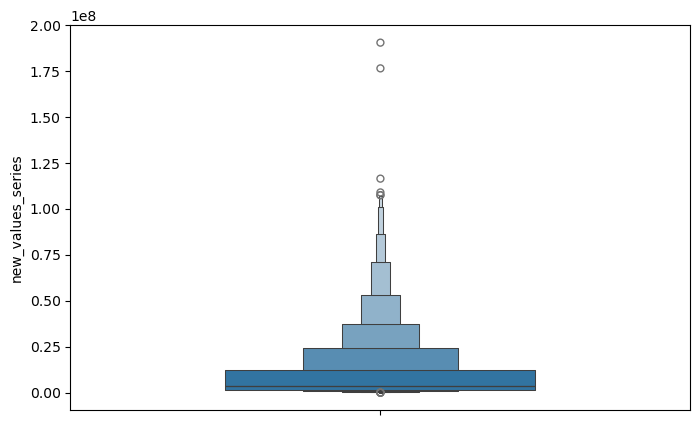

In [ ]:
plt.figure(figsize=(8,5))
sns.boxenplot(y='new_values_series', data= df, width= 0.5)
plt.show()

# frequrency distribution of player actual values

/tmp/ipykernel_217016/2970051373.py:4: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(x).set_title('Frequency Distribution Plot of Player Actual Values')


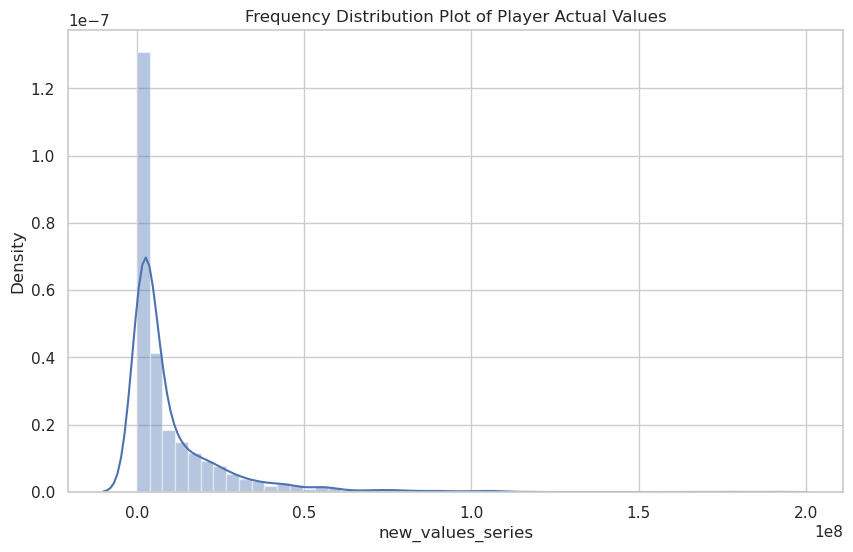

In [ ]:
x = df.new_values_series
sns.set(style="whitegrid")
plt.figure(figsize=(10,6))
sns.distplot(x).set_title('Frequency Distribution Plot of Player Actual Values')
plt.show()

# Regplot

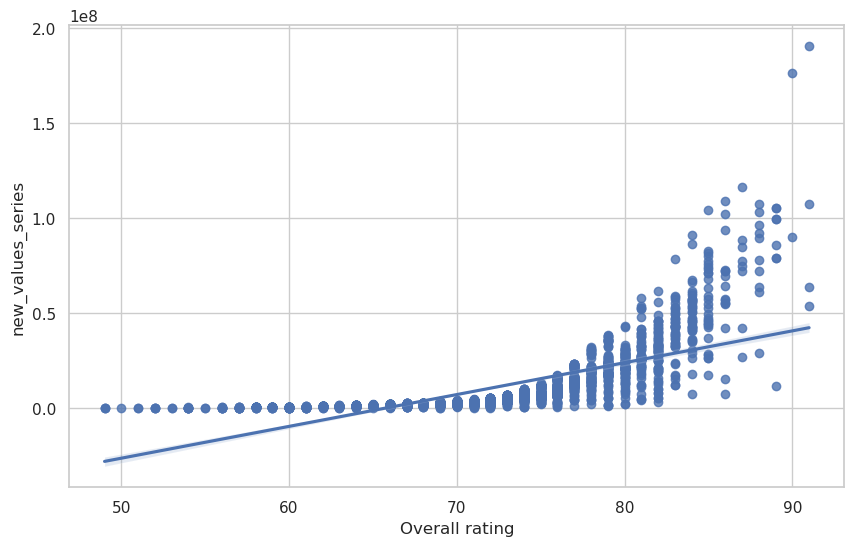

In [ ]:

plt.figure(figsize=(10,6))
sns.regplot(x="Overall rating",y="new_values_series",data=df)
plt.show()

<h2>Pie chart of player position distribution

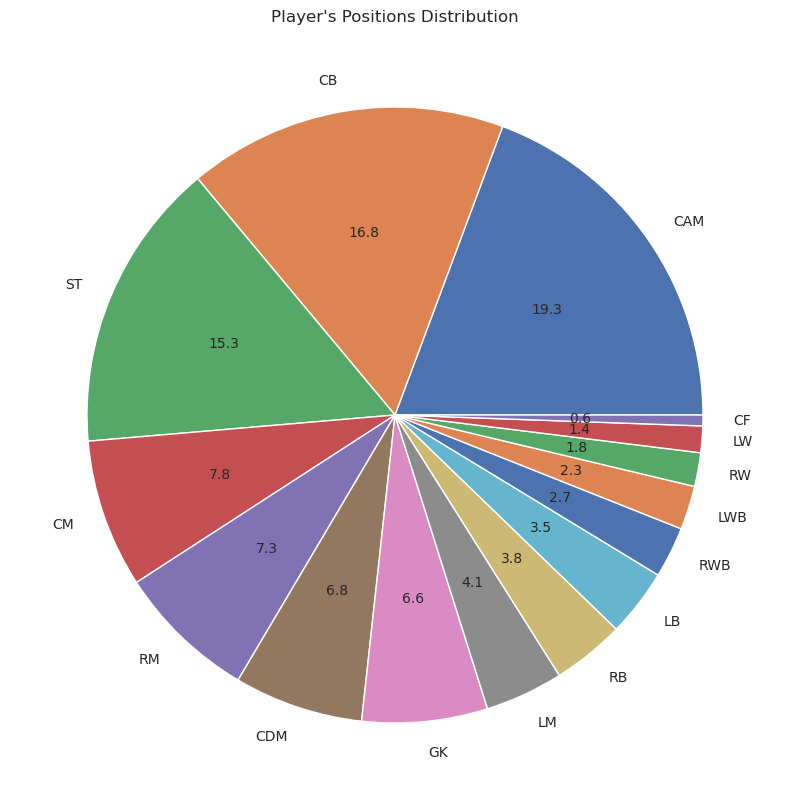

In [ ]:
plt.figure(figsize=(10,10))
loc=df['Best position'].value_counts()
loc.plot(kind='pie' ,autopct='%.1f',fontsize=10,subplots=True)
plt.title("Player's Positions Distribution")
plt.ylabel("")
plt.show()


<h2>Catplot of player best position

<Figure size 2000x2000 with 0 Axes>

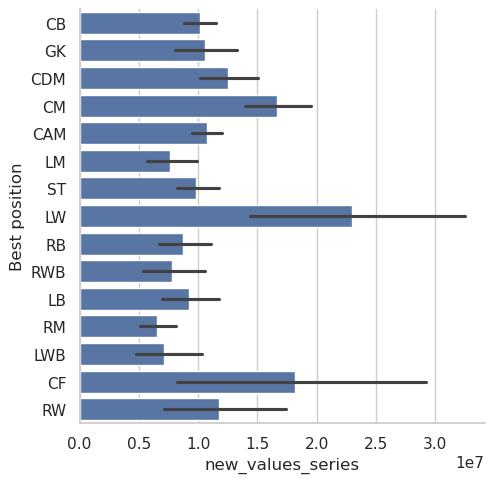

In [ ]:
plt.figure(figsize=(10,10),dpi=200)
graph = sns.catplot(y="Best position", x="new_values_series", kind="bar",  data=df)
plt.show()


# Wisker plot of footer value to check ouliers

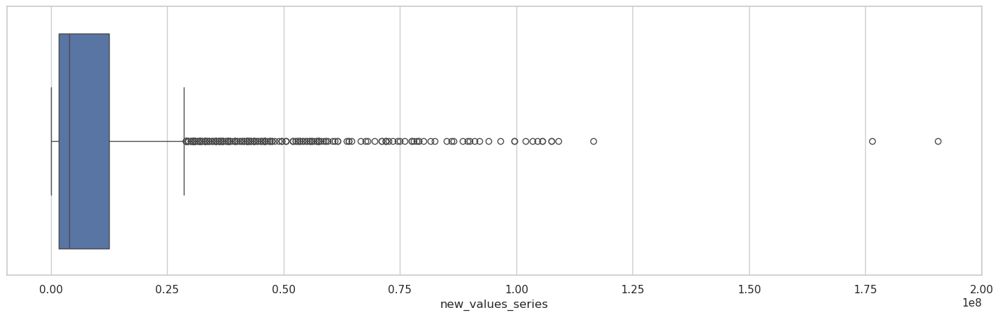

In [ ]:

plt.figure(figsize=[18,5])
sns.boxplot(x=df['new_values_series'], data=df);


In [ ]:
correlation_matrix = df.select_dtypes(include= [np.number]).corr()

correlation_with_target= correlation_matrix['new_values_series']



In [ ]:
sorted_correlation = correlation_with_target.sort_values(ascending=False)
sorted_correlation


new_values_series            1.000000
new_release_clause_series    0.965262
new_wages_series             0.786932
Best overall                 0.726185
Overall rating               0.723413
Reactions                    0.666374
Potential                    0.615855
Base stats                   0.615251
International reputation     0.553836
Passing / Kicking            0.530714
Dribbling / Reflexes         0.518444
Composure                    0.498339
Total stats                  0.450358
Vision                       0.433998
Short passing                0.406205
Long passing                 0.394878
Total power                  0.382245
Shot power                   0.368632
Shooting / Handling          0.361047
Total mentality              0.356285
Total skill                  0.332938
Ball control                 0.331851
Total attacking              0.324236
Curve                        0.286079
Stamina                      0.282124
Total movement               0.278423
Volleys     

# Create a list of tuples with variable name and correlation value pairs


In [ ]:
sorted_correlation_list = [(variable, correlation) for variable, correlation in sorted_correlation.items()]


# Display the sorted correlation values and names


In [ ]:
print("Sorted correlation values and names:")
for variable, correlation in sorted_correlation_list:
    print(f"{variable}: {correlation}")



Sorted correlation values and names:
new_values_series: 1.0
new_release_clause_series: 0.9652618048543862
new_wages_series: 0.7869318111646627
Best overall: 0.7261854028510851
Overall rating: 0.7234132509585884
Reactions: 0.6663740720978064
Potential: 0.6158545938516604
Base stats: 0.615250817729225
International reputation: 0.5538362598176735
Passing / Kicking: 0.5307137470103389
Dribbling / Reflexes: 0.5184442054230907
Composure: 0.498338713972533
Total stats: 0.45035806195055805
Vision: 0.43399794396142394
Short passing: 0.4062051134671618
Long passing: 0.3948775871838477
Total power: 0.38224511951173645
Shot power: 0.3686317929126348
Shooting / Handling: 0.36104703919012127
Total mentality: 0.356284875607681
Total skill: 0.332938329024953
Ball control: 0.3318511482203543
Total attacking: 0.32423641433422545
Curve: 0.2860792129510588
Stamina: 0.28212363839821486
Total movement: 0.2784229421749945
Volleys: 0.27413001879161036
Dribbling: 0.2711107275129491
Long shots: 0.27084189759486

<h2>Dropping unneccesary columns

In [ ]:

df.drop(['ID','Growth','Wage', 'Release clause','Crossing','Short passing','Volleys','Dribbling','Curve','FK Accuracy','Long passing','Acceleration','Sprint speed','Agility','Reactions','Balance','Jumping','Stamina','Long shots','Aggression','Interceptions','Penalties','Composure','Total defending','Marking','Standing tackle','Sliding tackle','Total goalkeeping','Base stats','contract',
         'Best overall','Total attacking','Heading accuracy','Positioning','Vision','Strength','Total skill','Best position','team','Total stats'
        
   
        ],axis=1,inplace=True)

In [ ]:
df.columns

Index(['name', 'Age', 'Overall rating', 'Potential', 'Height', 'Weight',
       'Value', 'Finishing', 'Ball control', 'Total movement', 'Total power',
       'Shot power', 'Total mentality', 'GK Diving', 'GK Handling',
       'GK Kicking', 'GK Positioning', 'GK Reflexes',
       'International reputation', 'Pace / Diving', 'Shooting / Handling',
       'Passing / Kicking', 'Dribbling / Reflexes', 'Defending / Pace',
       'Team & Contract', 'new_values', 'new_values_series', 'Team',
       'new_wages', 'new_wages_series', 'new_release_clause',
       'new_release_clause_series', 'foot_Right'],
      dtype='object')

# Correlation heat map with new columns

Text(0.5, 1.0, 'Correlation Heatmap')

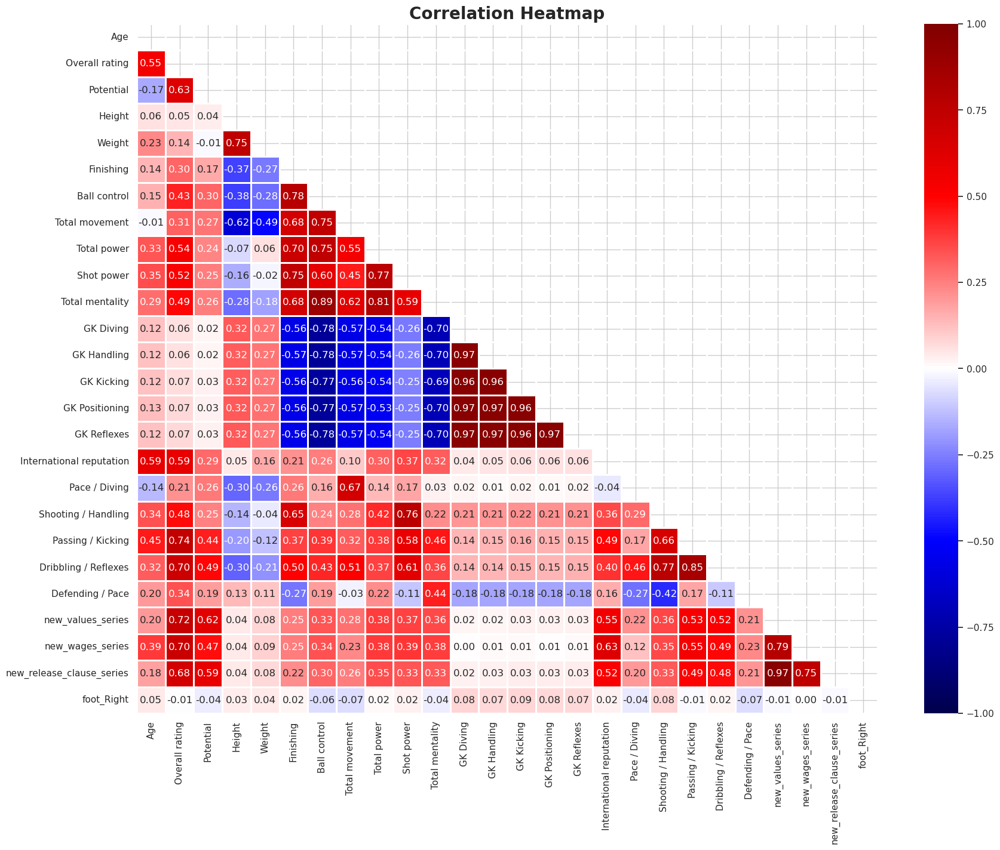

In [ ]:
corr_matrix = df.select_dtypes(include=[np.number]).corr()
fig = plt.figure(figsize=[20,15])
mask = np.triu(np.ones_like(corr_matrix, dtype=bool))
sns.heatmap(corr_matrix,cmap='seismic',linewidth=1,linecolor='white',vmax = 1, vmin=-1,mask=mask, annot=True,fmt='0.2f')
plt.title('Correlation Heatmap', weight='bold',fontsize=20)

In [ ]:
df = df.drop(['Height','Weight','foot_Right'],axis=1)


# Correlation heat map with new columns

Text(0.5, 1.0, 'Correlation Heatmap')

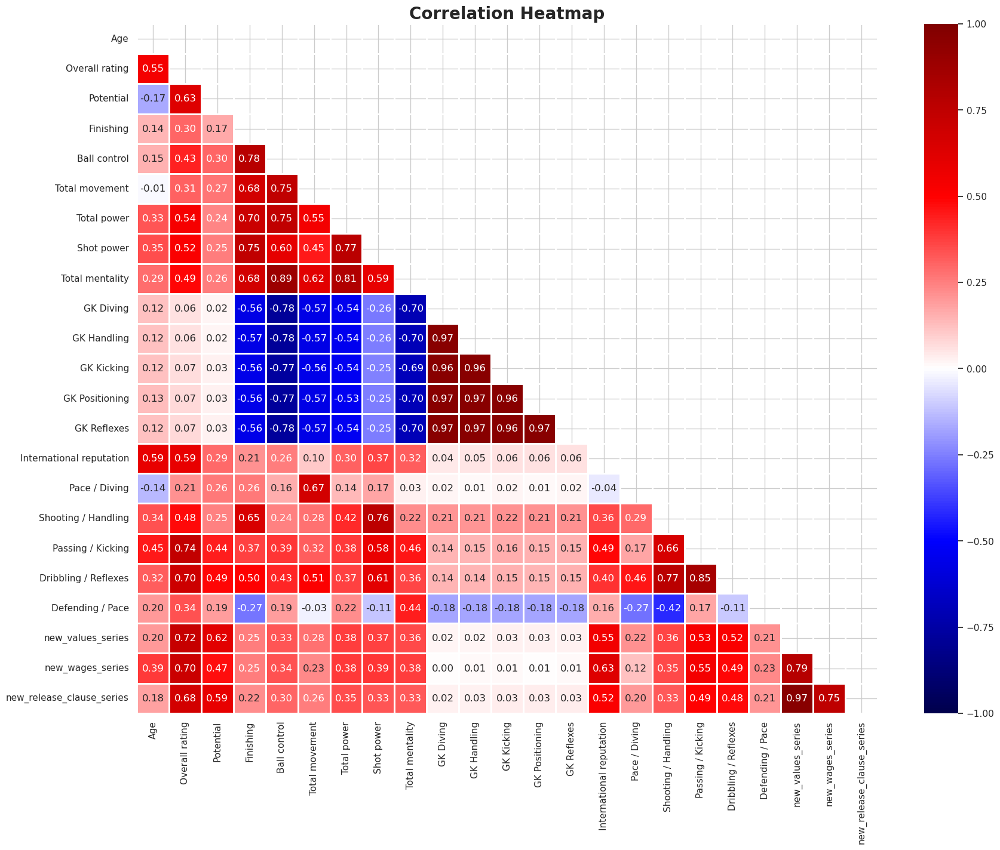

In [ ]:
corr_matrix = df.select_dtypes(include=[np.number]).corr()
fig = plt.figure(figsize=[20,15])
mask = np.triu(np.ones_like(corr_matrix, dtype=bool))
sns.heatmap(corr_matrix,cmap='seismic',linewidth=1,linecolor='white',vmax = 1, vmin=-1,mask=mask, annot=True,fmt='0.2f')
plt.title('Correlation Heatmap', weight='bold',fontsize=20)

# Distribution of scoring ratings

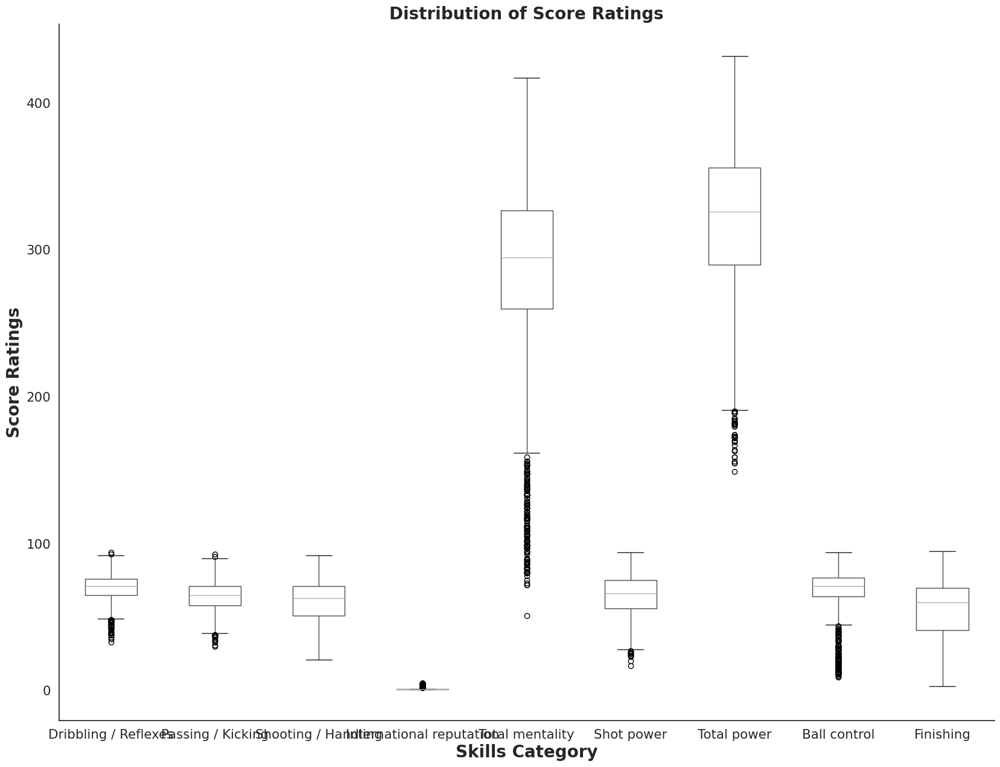

In [ ]:
fig = plt.figure(figsize=[20,15])
sns.set(style='white', font_scale=1.4)
df[['Dribbling / Reflexes','Passing / Kicking','Shooting / Handling','International reputation','Total mentality','Shot power','Total power','Ball control','Finishing']].boxplot()
plt.grid(False)
plt.xlabel('Skills Category', fontsize=20, weight='bold')
plt.ylabel('Score Ratings', fontsize=20, weight='bold')
plt.title('Distribution of Score Ratings', fontsize=20, weight='bold')
sns.despine()

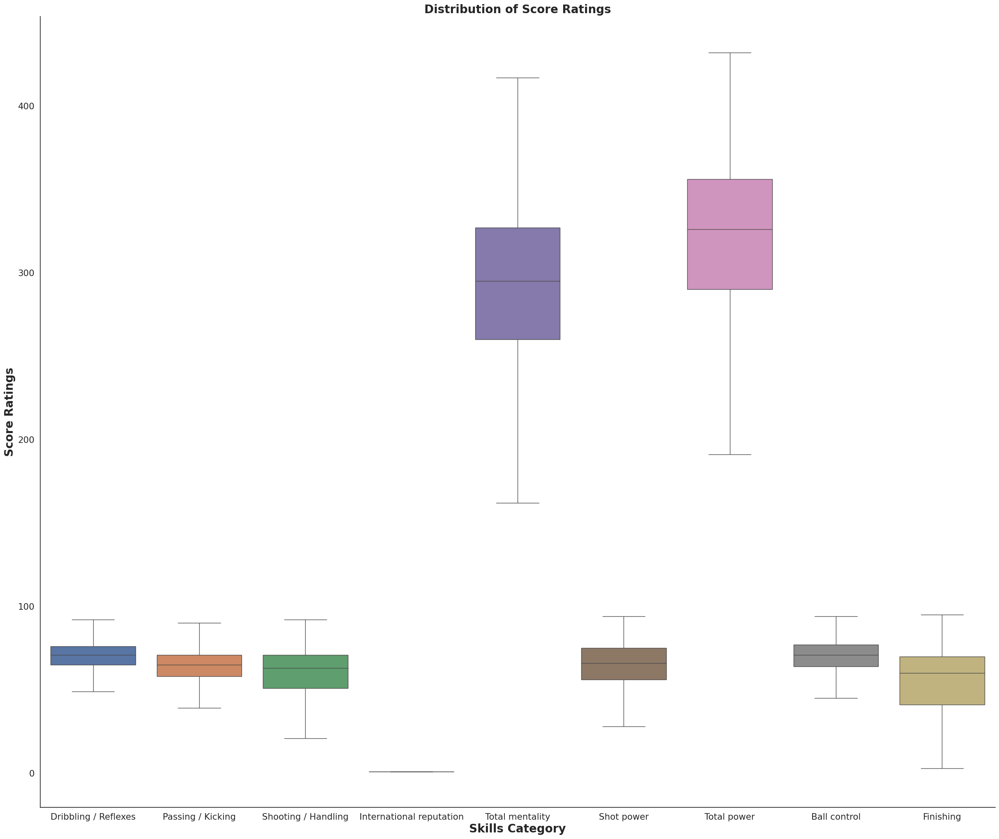

In [ ]:
fig = plt.figure(figsize=[30,25])
sns.set(style='white', font_scale=1.4)
data = df[['Dribbling / Reflexes','Passing / Kicking','Shooting / Handling','International reputation','Total mentality','Shot power','Total power','Ball control','Finishing']]
sns.boxplot(data=data, showfliers=False)
plt.grid(False)
plt.xlabel('Skills Category', fontsize=20, weight='bold')
plt.ylabel('Score Ratings', fontsize=20, weight='bold')
plt.title('Distribution of Score Ratings', fontsize=20, weight='bold')
sns.despine()

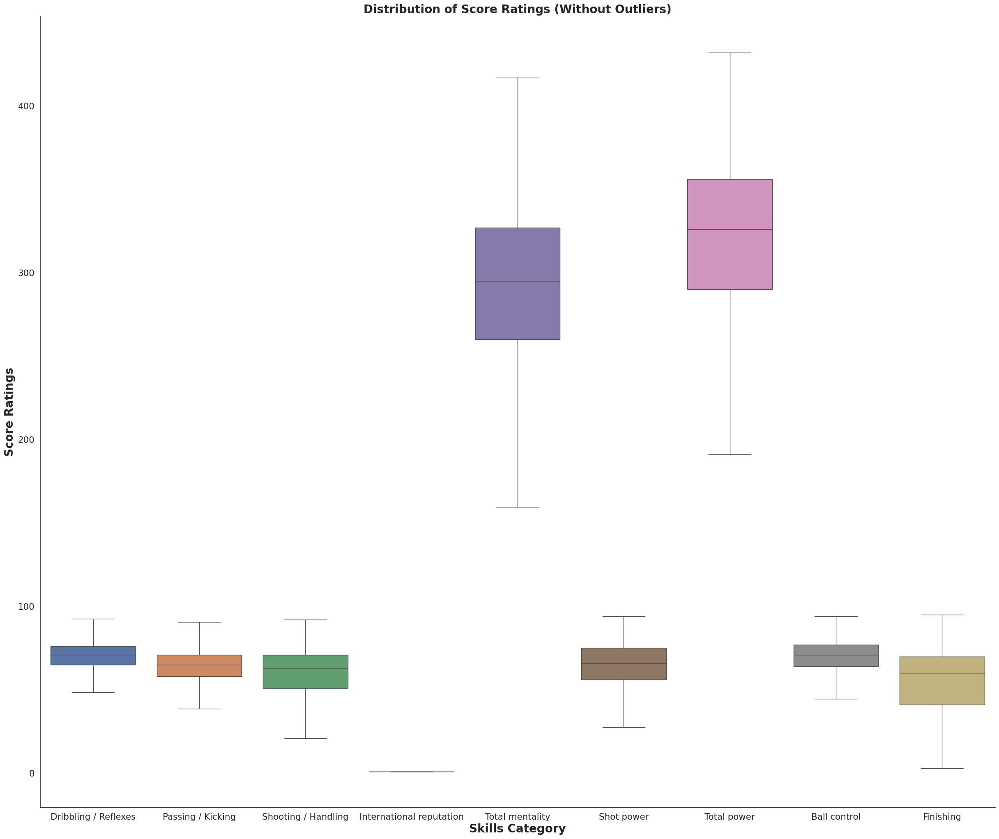

In [ ]:
numeric_df = df.select_dtypes(include=[np.number])
# Calculate the IQR for each column
Q1 = numeric_df.quantile(0.25)
Q3 = numeric_df.quantile(0.75)
IQR = Q3 - Q1

# Define the upper and lower bounds to identify outliers
lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

# # Filter out the outliers from the dataset
# filtered_df = numeric_df[~((numeric_df < lower_bound) | (numeric_df > upper_bound)).any(axis=1)]
clipped_df = numeric_df.clip(lower=lower_bound, upper=upper_bound, axis=1)



# Create the boxplot with the filtered dataset
fig = plt.figure(figsize=[30,25])
sns.set(style='white', font_scale=1.4)
data = clipped_df[['Dribbling / Reflexes', 'Passing / Kicking', 'Shooting / Handling', 'International reputation', 'Total mentality', 'Shot power', 'Total power', 'Ball control', 'Finishing']]
sns.boxplot(data=data)
plt.grid(False)
plt.xlabel('Skills Category', fontsize=20, weight='bold')
plt.ylabel('Score Ratings', fontsize=20, weight='bold')
plt.title('Distribution of Score Ratings (Without Outliers)', fontsize=20, weight='bold')
sns.despine()

<h2>pairwise scatter plot showing the relationship between the variables in the data set

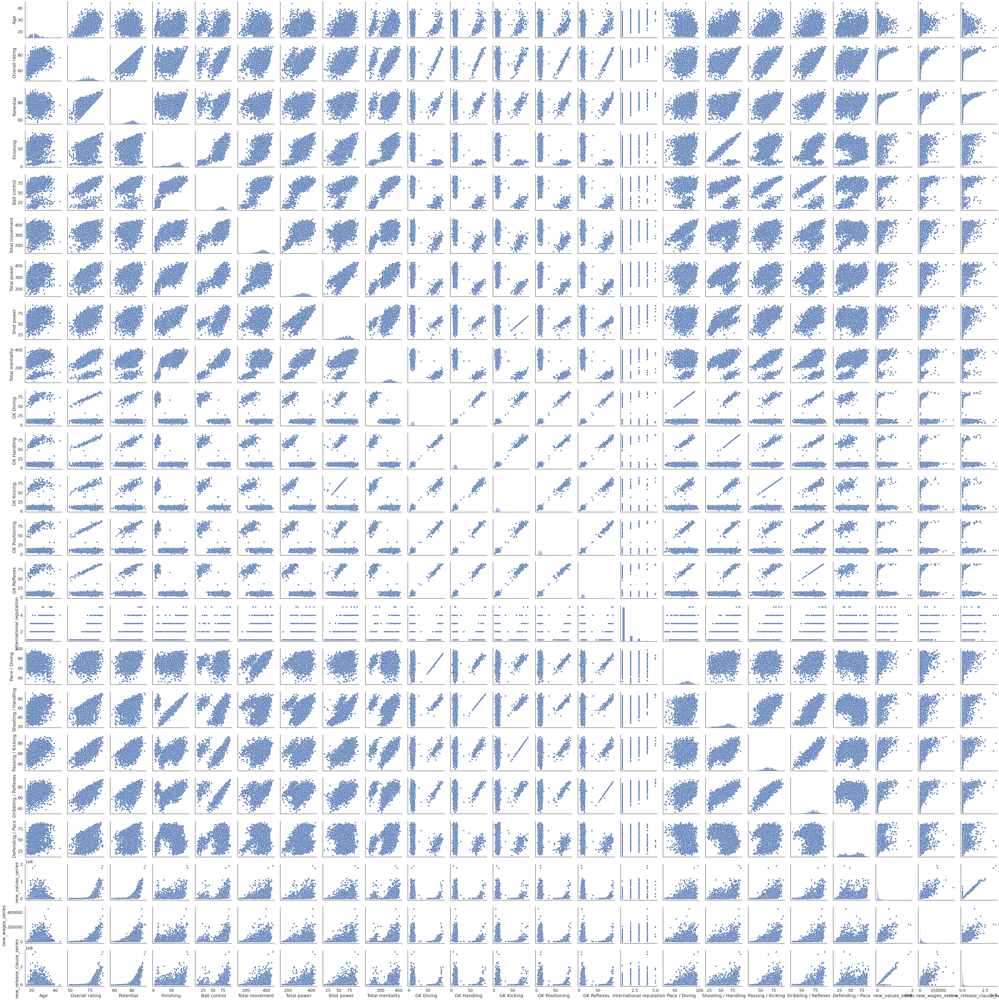

In [ ]:
numeric_df = df.select_dtypes(include=[np.number])

sns.set(style='white',font_scale=1.5)
sns.pairplot(df)

<h2>
Selecting the features that affect the correlation the most and assigning them to the new dataset

In [ ]:
selected_columns = ['name','Age','Dribbling / Reflexes', 'Passing / Kicking', 'Shooting / Handling', 'International reputation', 'Total mentality', 'Shot power', 'Total power', 'Ball control', 'Finishing','new_values_series']
new_df = df[selected_columns].copy()
new_df.head()

,name,Age,Dribbling / Reflexes,Passing / Kicking,Shooting / Handling,International reputation,Total mentality,Shot power,Total power,Ball control,Finishing,new_values_series
0,J. Todibo,22,67,63,47,1,305,60,335,72,44,24500000.0
1,B. Verbruggen,19,76,71,70,1,99,53,218,18,8,5500000.0
2,M. Ugarte,21,77,71,63,1,355,62,336,77,65,26000000.0
3,Z. Debast,18,67,67,53,1,295,60,327,71,51,3500000.0
5,E. Camavinga,19,82,79,66,3,367,73,371,85,62,52500000.0


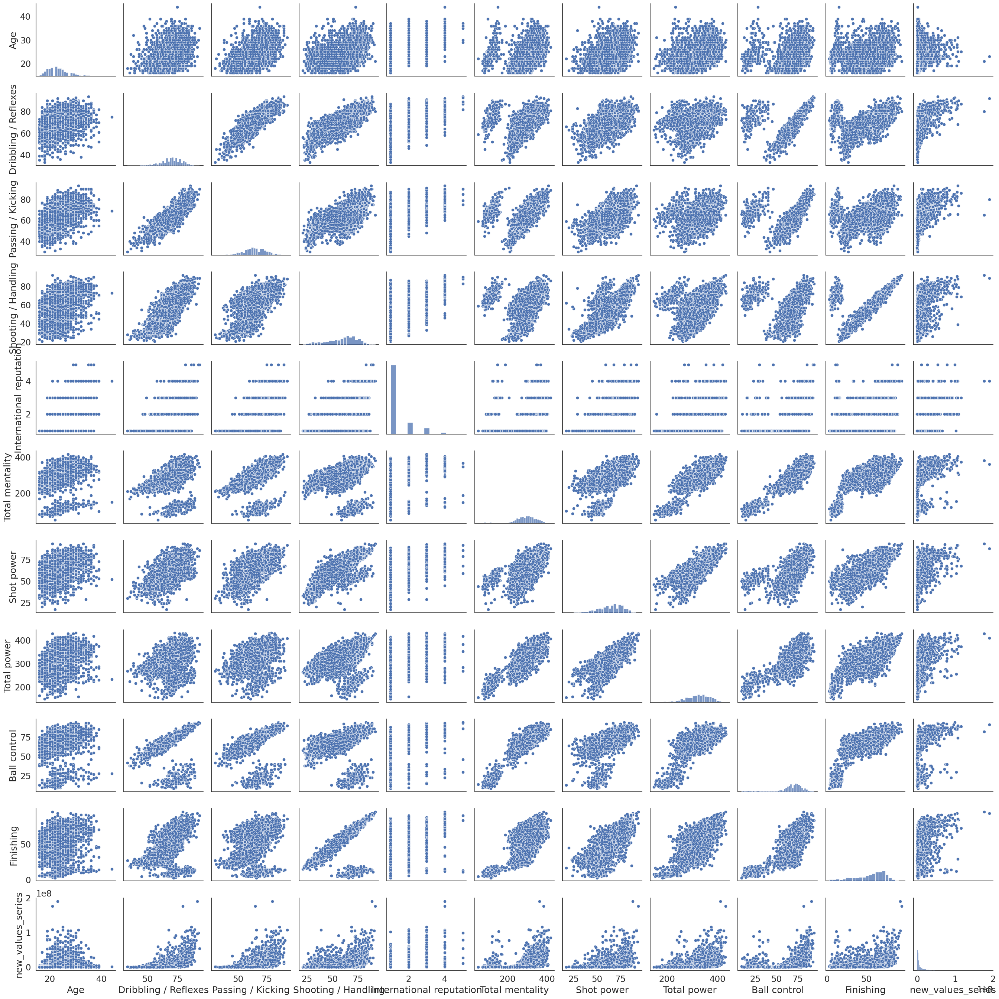

In [ ]:
sns.set(style='white',font_scale=1.5)
sns.pairplot(new_df)

In [ ]:
y, X = patsy.dmatrices("Q('new_values_series') ~ Q('Age') + Q('Dribbling / Reflexes') + Q('Passing / Kicking') + Q('Shooting / Handling') + Q('International reputation') + Q('Total mentality') + Q('Shot power') + Q('Total power') + Q('Ball control') + Q('Finishing')", data=new_df, return_type="dataframe")
model = sm.OLS(y, X)
fit = model.fit()
fit.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                              OLS Regression Results                              
==================================================================================
Dep. Variable:     Q('new_values_series')   R-squared:                       0.528
Model:                                OLS   Adj. R-squared:                  0.526
Method:                     Least Squares   F-statistic:                     295.9
Date:                    Thu, 09 Jan 2025   Prob (F-statistic):               0.00
Time:                            20:44:41   Log-Likelihood:                -46863.
No. Observations:                    2656   AIC:                         9.375e+04
Df Residuals:                        2645   BIC:                         9.381e+04
Df Model:                              10                                         
Covariance Type:                nonrobust                                         
=================================================================================================
                                    coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------------------
Intercept                     -5.713e+07   2.48e+06    -23.079      0.000    -6.2e+07   -5.23e+07
Q('Age')                      -1.303e+06   6.76e+04    -19.270      0.000   -1.44e+06   -1.17e+06
Q('Dribbling / Reflexes')      4.121e+05      7e+04      5.888      0.000    2.75e+05    5.49e+05
Q('Passing / Kicking')         1.852e+05   5.96e+04      3.106      0.002    6.83e+04    3.02e+05
Q('Shooting / Handling')       3.332e+05   8.15e+04      4.088      0.000    1.73e+05    4.93e+05
Q('International reputation')  1.172e+07   4.07e+05     28.764      0.000    1.09e+07    1.25e+07
Q('Total mentality')           3984.1807   1.09e+04      0.364      0.716   -1.75e+04    2.54e+04
Q('Shot power')               -3.456e+05   4.63e+04     -7.460      0.000   -4.36e+05   -2.55e+05
Q('Total power')               1.497e+05   1.05e+04     14.229      0.000    1.29e+05     1.7e+05
Q('Ball control')              2.023e+05   6.51e+04      3.107      0.002    7.46e+04     3.3e+05
Q('Finishing')                -3.431e+05      5e+04     -6.863      0.000   -4.41e+05   -2.45e+05
==============================================================================
Omnibus:                     1725.196   Durbin-Watson:                   1.559
Prob(Omnibus):                  0.000   Jarque-Bera (JB):            41778.363
Skew:                           2.682   Prob(JB):                         0.00
Kurtosis:                      21.674   Cond. No.                     5.32e+03
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 5.32e+03. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

In [ ]:
df1 = new_df.copy()


In [ ]:
mask = new_df['new_values_series'] > 0  # Create a boolean mask for non-zero values
df1['new_values_series'] = np.log(new_df.loc[mask, 'new_values_series'])  # Apply log only to non-zero values

In [ ]:
df1 = df1.rename(columns={'new_values_series':'Log Market Value'})


# Correlation with final features

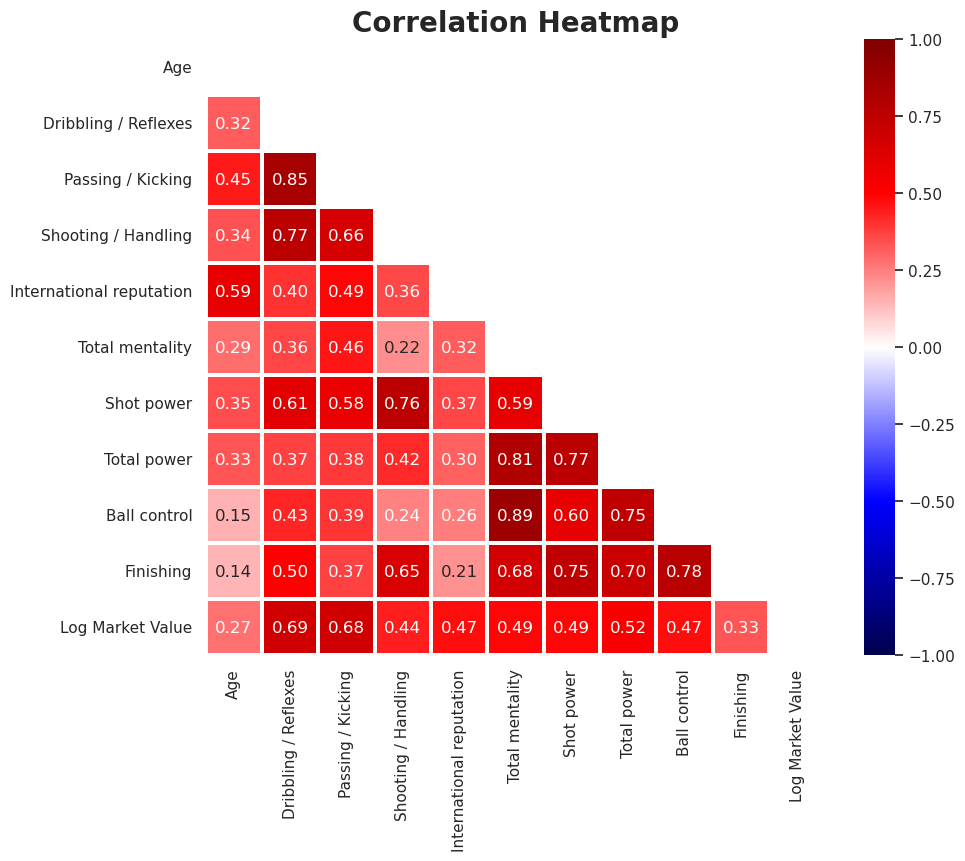

In [ ]:

sns.set(font_scale=1,style='white')
corr_matrix = df1.select_dtypes(include= [np.number]).corr()
fig = plt.figure(figsize=[10,8])
mask = np.triu(np.ones_like(corr_matrix, dtype=bool))
sns.heatmap(corr_matrix,cmap='seismic',linewidth=1.5,linecolor='white',vmax = 1, vmin=-1,mask=mask, annot=True,fmt='0.2f')
plt.title('Correlation Heatmap', weight='bold',fontsize=20)
plt.savefig('heatmap3.png',transparent=True, bbox_inches='tight')

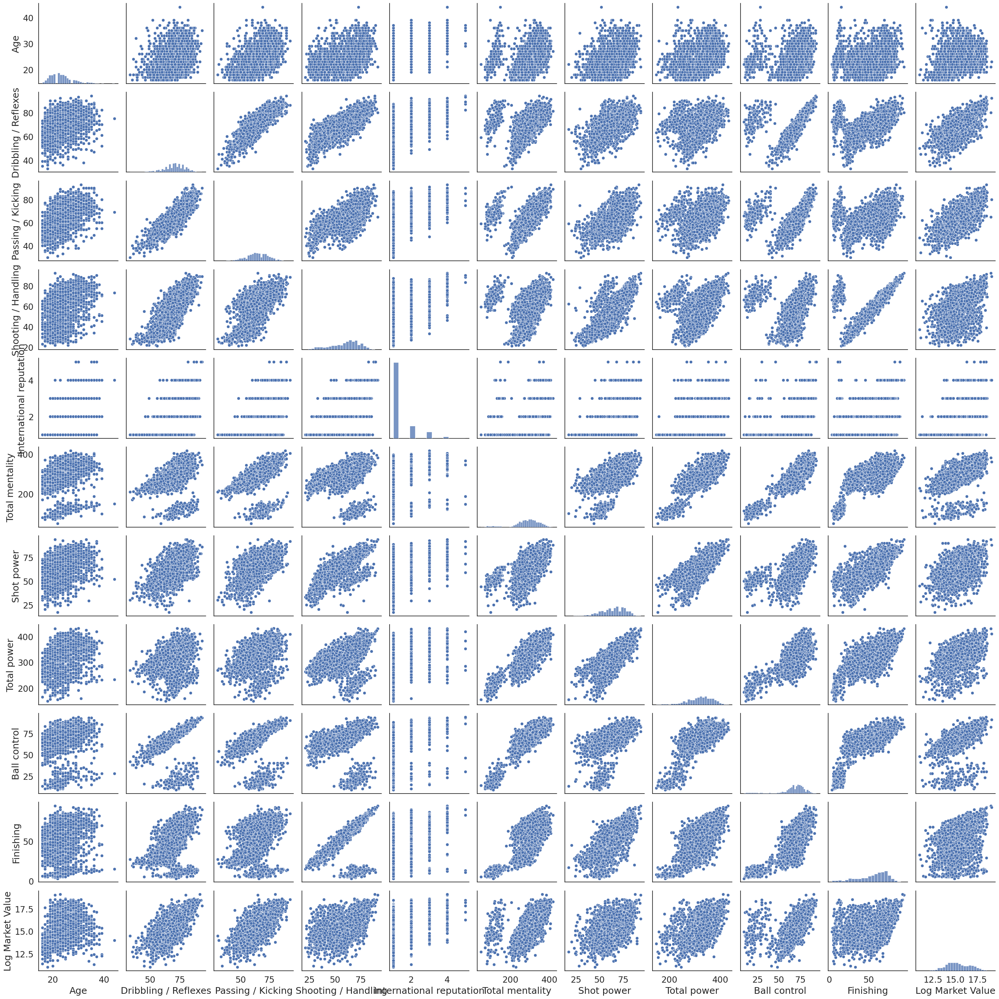

In [ ]:

sns.set(style='white', font_scale=1.5)
sns.pairplot(df1)
plt.savefig('pairplot2.png', transparent=True, bbox_inches='tight')

<h2>
Taking the logarithm of the market values created a normal distribution and increased the R-sq value

In [ ]:
y, X = patsy.dmatrices("Q('Log Market Value') ~ Q('Age') + Q('Dribbling / Reflexes') + Q('Passing / Kicking') + Q('Shooting / Handling') + Q('International reputation') + Q('Total mentality') + Q('Shot power') + Q('Total power') + Q('Ball control') + Q('Finishing')", data=df1, return_type="dataframe")

model = sm.OLS(y, X)
fit = model.fit()
fit.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                              OLS Regression Results                             
=================================================================================
Dep. Variable:     Q('Log Market Value')   R-squared:                       0.696
Model:                               OLS   Adj. R-squared:                  0.695
Method:                    Least Squares   F-statistic:                     606.0
Date:                   Thu, 09 Jan 2025   Prob (F-statistic):               0.00
Time:                           20:45:14   Log-Likelihood:                -2975.5
No. Observations:                   2656   AIC:                             5973.
Df Residuals:                       2645   BIC:                             6038.
Df Model:                             10                                         
Covariance Type:               nonrobust                                         
=================================================================================================
                                    coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------------------
Intercept                         5.7663      0.165     34.956      0.000       5.443       6.090
Q('Age')                         -0.0681      0.005    -15.122      0.000      -0.077      -0.059
Q('Dribbling / Reflexes')         0.0623      0.005     13.370      0.000       0.053       0.071
Q('Passing / Kicking')            0.0184      0.004      4.640      0.000       0.011       0.026
Q('Shooting / Handling')          0.0312      0.005      5.749      0.000       0.021       0.042
Q('International reputation')     0.4184      0.027     15.412      0.000       0.365       0.472
Q('Total mentality')              0.0003      0.001      0.383      0.702      -0.001       0.002
Q('Shot power')                  -0.0286      0.003     -9.274      0.000      -0.035      -0.023
Q('Total power')                  0.0156      0.001     22.206      0.000       0.014       0.017
Q('Ball control')                 0.0347      0.004      7.987      0.000       0.026       0.043
Q('Finishing')                   -0.0444      0.003    -13.316      0.000      -0.051      -0.038
==============================================================================
Omnibus:                       38.187   Durbin-Watson:                   1.663
Prob(Omnibus):                  0.000   Jarque-Bera (JB):               40.631
Skew:                           0.268   Prob(JB):                     1.50e-09
Kurtosis:                       3.281   Cond. No.                     5.32e+03
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 5.32e+03. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

In [ ]:
df1.isnull().sum()

name                        0
Age                         0
Dribbling / Reflexes        0
Passing / Kicking           0
Shooting / Handling         0
International reputation    0
Total mentality             0
Shot power                  0
Total power                 0
Ball control                0
Finishing                   0
Log Market Value            0
dtype: int64

In [ ]:
df1.drop(columns=['name'],inplace=True)

In [ ]:
# selected_columns2 = ['Age','Dribbling / Reflexes', 'Passing / Kicking', 'Shooting / Handling', 'International reputation', 'Shot power', 'Total power', 
#                      'Ball control', 'Finishing']

# selected_columns = ['name','Age','Dribbling / Reflexes', 'Passing / Kicking', 'Shooting / Handling', 'International reputation', 'Total mentality', 'Shot power',
#                      'Total power', 'Ball control', 'Finishing','Value']


In [ ]:
df1.head()

,Age,Dribbling / Reflexes,Passing / Kicking,Shooting / Handling,International reputation,Total mentality,Shot power,Total power,Ball control,Finishing,Log Market Value
0,22,67,63,47,1,305,60,335,72,44,17.014184
1,19,76,71,70,1,99,53,218,18,8,15.520259
2,21,77,71,63,1,355,62,336,77,65,17.073607
3,18,67,67,53,1,295,60,327,71,51,15.068274
5,19,82,79,66,3,367,73,371,85,62,17.776324


# Create final csv fit for model

<h2>pairwise scatter plot showing the relationship between the variables in the data set

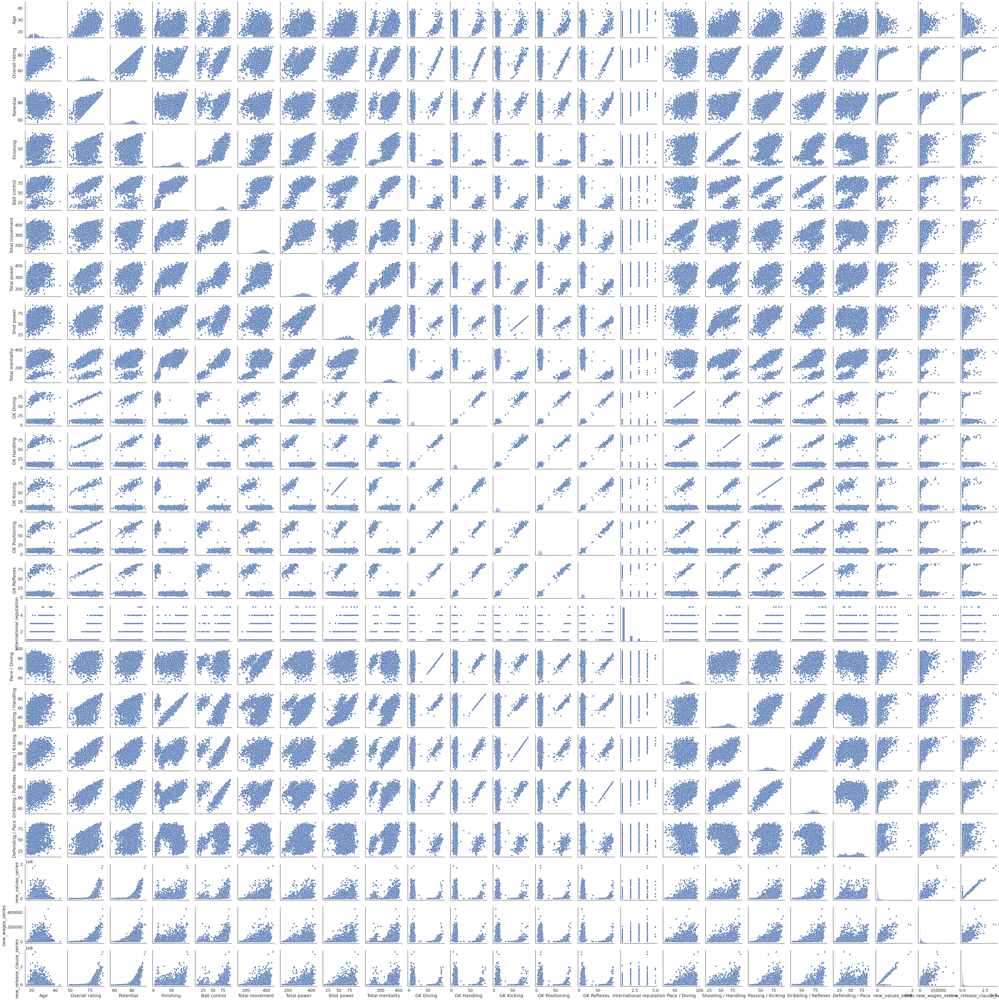

In [40]:
numeric_df = df.select_dtypes(include=[np.number])

sns.set(style='white',font_scale=1.5)
sns.pairplot(df)

<h2>
Selecting the features that affect the correlation the most and assigning them to the new dataset

In [41]:
selected_columns = ['name','Age','Dribbling / Reflexes', 'Passing / Kicking', 'Shooting / Handling', 'International reputation', 'Total mentality', 'Shot power', 'Total power', 'Ball control', 'Finishing','new_values_series']
new_df = df[selected_columns].copy()
new_df.head()

,name,Age,Dribbling / Reflexes,Passing / Kicking,Shooting / Handling,International reputation,Total mentality,Shot power,Total power,Ball control,Finishing,new_values_series
0,J. Todibo,22,67,63,47,1,305,60,335,72,44,24500000.0
1,B. Verbruggen,19,76,71,70,1,99,53,218,18,8,5500000.0
2,M. Ugarte,21,77,71,63,1,355,62,336,77,65,26000000.0
3,Z. Debast,18,67,67,53,1,295,60,327,71,51,3500000.0
5,E. Camavinga,19,82,79,66,3,367,73,371,85,62,52500000.0


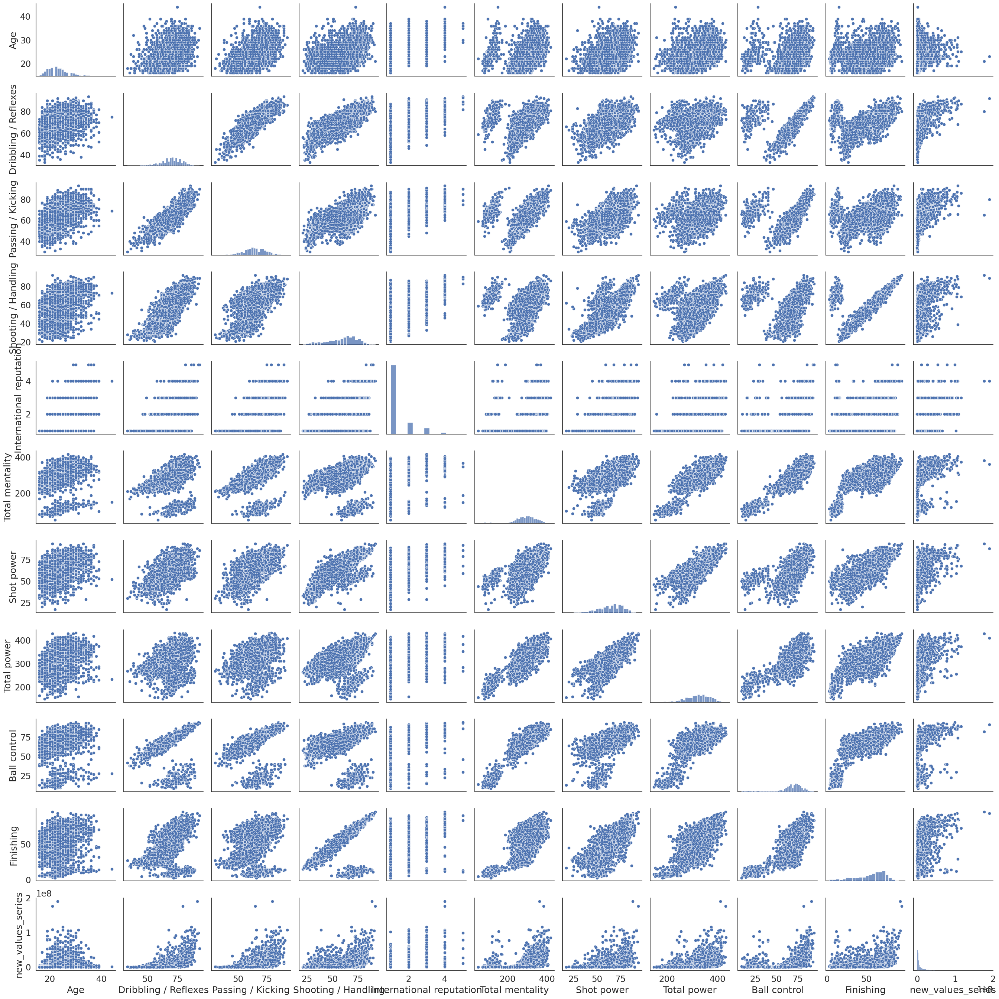

In [42]:
sns.set(style='white',font_scale=1.5)
sns.pairplot(new_df)

In [43]:
y, X = patsy.dmatrices("Q('new_values_series') ~ Q('Age') + Q('Dribbling / Reflexes') + Q('Passing / Kicking') + Q('Shooting / Handling') + Q('International reputation') + Q('Total mentality') + Q('Shot power') + Q('Total power') + Q('Ball control') + Q('Finishing')", data=new_df, return_type="dataframe")
model = sm.OLS(y, X)
fit = model.fit()
fit.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                              OLS Regression Results                              
==================================================================================
Dep. Variable:     Q('new_values_series')   R-squared:                       0.528
Model:                                OLS   Adj. R-squared:                  0.526
Method:                     Least Squares   F-statistic:                     295.9
Date:                    Thu, 09 Jan 2025   Prob (F-statistic):               0.00
Time:                            20:44:41   Log-Likelihood:                -46863.
No. Observations:                    2656   AIC:                         9.375e+04
Df Residuals:                        2645   BIC:                         9.381e+04
Df Model:                              10                                         
Covariance Type:                nonrobust                                         
=================================================================================================
                                    coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------------------
Intercept                     -5.713e+07   2.48e+06    -23.079      0.000    -6.2e+07   -5.23e+07
Q('Age')                      -1.303e+06   6.76e+04    -19.270      0.000   -1.44e+06   -1.17e+06
Q('Dribbling / Reflexes')      4.121e+05      7e+04      5.888      0.000    2.75e+05    5.49e+05
Q('Passing / Kicking')         1.852e+05   5.96e+04      3.106      0.002    6.83e+04    3.02e+05
Q('Shooting / Handling')       3.332e+05   8.15e+04      4.088      0.000    1.73e+05    4.93e+05
Q('International reputation')  1.172e+07   4.07e+05     28.764      0.000    1.09e+07    1.25e+07
Q('Total mentality')           3984.1807   1.09e+04      0.364      0.716   -1.75e+04    2.54e+04
Q('Shot power')               -3.456e+05   4.63e+04     -7.460      0.000   -4.36e+05   -2.55e+05
Q('Total power')               1.497e+05   1.05e+04     14.229      0.000    1.29e+05     1.7e+05
Q('Ball control')              2.023e+05   6.51e+04      3.107      0.002    7.46e+04     3.3e+05
Q('Finishing')                -3.431e+05      5e+04     -6.863      0.000   -4.41e+05   -2.45e+05
==============================================================================
Omnibus:                     1725.196   Durbin-Watson:                   1.559
Prob(Omnibus):                  0.000   Jarque-Bera (JB):            41778.363
Skew:                           2.682   Prob(JB):                         0.00
Kurtosis:                      21.674   Cond. No.                     5.32e+03
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 5.32e+03. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

In [44]:
df1 = new_df.copy()


In [45]:
mask = new_df['new_values_series'] > 0  # Create a boolean mask for non-zero values
df1['new_values_series'] = np.log(new_df.loc[mask, 'new_values_series'])  # Apply log only to non-zero values

In [46]:
df1 = df1.rename(columns={'new_values_series':'Log Market Value'})


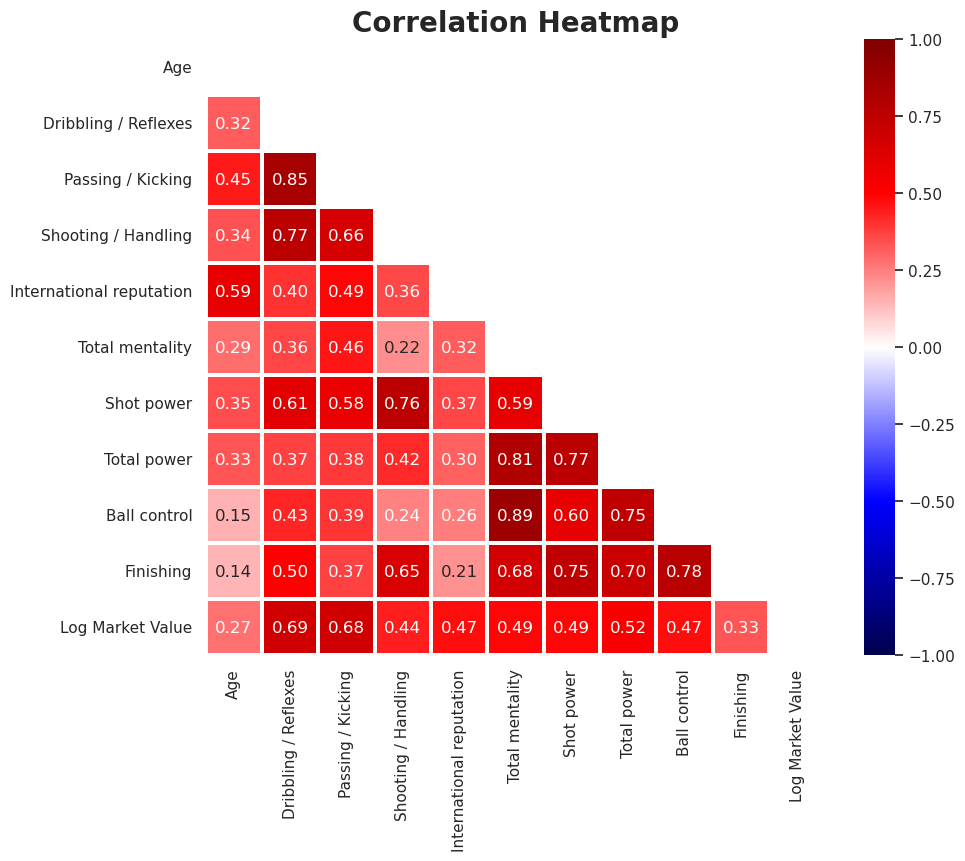

In [47]:

sns.set(font_scale=1,style='white')
corr_matrix = df1.select_dtypes(include= [np.number]).corr()
fig = plt.figure(figsize=[10,8])
mask = np.triu(np.ones_like(corr_matrix, dtype=bool))
sns.heatmap(corr_matrix,cmap='seismic',linewidth=1.5,linecolor='white',vmax = 1, vmin=-1,mask=mask, annot=True,fmt='0.2f')
plt.title('Correlation Heatmap', weight='bold',fontsize=20)
plt.savefig('heatmap3.png',transparent=True, bbox_inches='tight')

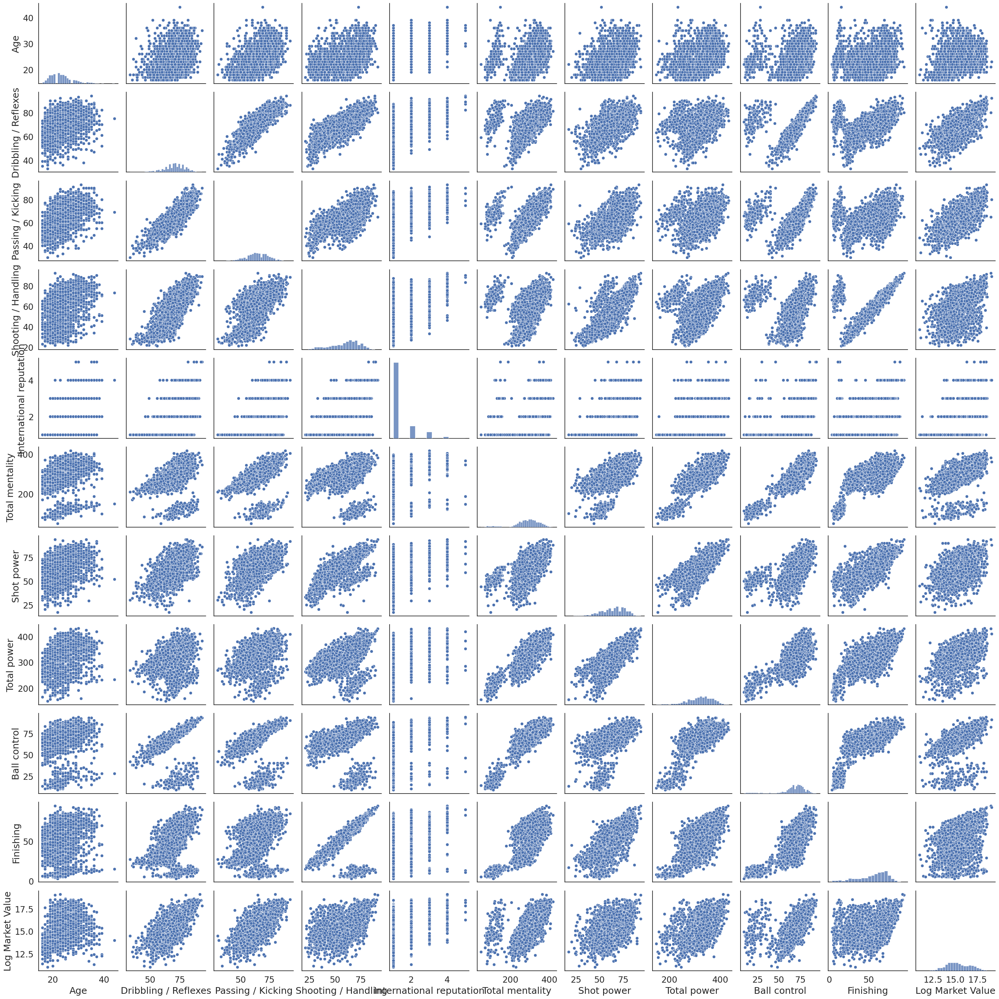

In [48]:

sns.set(style='white', font_scale=1.5)
sns.pairplot(df1)
plt.savefig('pairplot2.png', transparent=True, bbox_inches='tight')

<h2>
Taking the logarithm of the market values created a normal distribution and increased the R-sq value

In [49]:
y, X = patsy.dmatrices("Q('Log Market Value') ~ Q('Age') + Q('Dribbling / Reflexes') + Q('Passing / Kicking') + Q('Shooting / Handling') + Q('International reputation') + Q('Total mentality') + Q('Shot power') + Q('Total power') + Q('Ball control') + Q('Finishing')", data=df1, return_type="dataframe")

model = sm.OLS(y, X)
fit = model.fit()
fit.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                              OLS Regression Results                             
=================================================================================
Dep. Variable:     Q('Log Market Value')   R-squared:                       0.696
Model:                               OLS   Adj. R-squared:                  0.695
Method:                    Least Squares   F-statistic:                     606.0
Date:                   Thu, 09 Jan 2025   Prob (F-statistic):               0.00
Time:                           20:45:14   Log-Likelihood:                -2975.5
No. Observations:                   2656   AIC:                             5973.
Df Residuals:                       2645   BIC:                             6038.
Df Model:                             10                                         
Covariance Type:               nonrobust                                         
=================================================================================================
                                    coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------------------
Intercept                         5.7663      0.165     34.956      0.000       5.443       6.090
Q('Age')                         -0.0681      0.005    -15.122      0.000      -0.077      -0.059
Q('Dribbling / Reflexes')         0.0623      0.005     13.370      0.000       0.053       0.071
Q('Passing / Kicking')            0.0184      0.004      4.640      0.000       0.011       0.026
Q('Shooting / Handling')          0.0312      0.005      5.749      0.000       0.021       0.042
Q('International reputation')     0.4184      0.027     15.412      0.000       0.365       0.472
Q('Total mentality')              0.0003      0.001      0.383      0.702      -0.001       0.002
Q('Shot power')                  -0.0286      0.003     -9.274      0.000      -0.035      -0.023
Q('Total power')                  0.0156      0.001     22.206      0.000       0.014       0.017
Q('Ball control')                 0.0347      0.004      7.987      0.000       0.026       0.043
Q('Finishing')                   -0.0444      0.003    -13.316      0.000      -0.051      -0.038
==============================================================================
Omnibus:                       38.187   Durbin-Watson:                   1.663
Prob(Omnibus):                  0.000   Jarque-Bera (JB):               40.631
Skew:                           0.268   Prob(JB):                     1.50e-09
Kurtosis:                       3.281   Cond. No.                     5.32e+03
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 5.32e+03. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

In [50]:
df1.isnull().sum()

name                        0
Age                         0
Dribbling / Reflexes        0
Passing / Kicking           0
Shooting / Handling         0
International reputation    0
Total mentality             0
Shot power                  0
Total power                 0
Ball control                0
Finishing                   0
Log Market Value            0
dtype: int64

In [51]:
df1.drop(columns=['name'],inplace=True)

In [53]:
df1.head()

,Age,Dribbling / Reflexes,Passing / Kicking,Shooting / Handling,International reputation,Total mentality,Shot power,Total power,Ball control,Finishing,Log Market Value
0,22,67,63,47,1,305,60,335,72,44,17.014184
1,19,76,71,70,1,99,53,218,18,8,15.520259
2,21,77,71,63,1,355,62,336,77,65,17.073607
3,18,67,67,53,1,295,60,327,71,51,15.068274
5,19,82,79,66,3,367,73,371,85,62,17.776324


# Create final csv fit for model

In [54]:
df1.to_csv('footballer_data_final.csv', index=False)